In [1]:
# Import needed packages
from skimage import io, filters, morphology
from skimage import exposure
import numpy as np
import matplotlib.pyplot as plt
from pathlib import Path
import os
from mpl_toolkits.axes_grid1.anchored_artists import AnchoredSizeBar
from PIL import Image, ImageDraw
import tifffile

os.chdir("/Users/dylanschaff/Library/CloudStorage/GoogleDrive-dyschaff@sydshafferlab.com/My Drive/Schaff_Shared/Cloud/Schaff_paper/incucyte_analysis")
# Path to the images
path_to_imgs = '/Users/dylanschaff/Library/CloudStorage/GoogleDrive-dyschaff@sydshafferlab.com/My Drive/Schaff_Shared/Cloud/Schaff_paper/Data/DLS083_incucyte_data/Scans_for_paper'
# 287 pixels is 800 µm as measured by imageJ (scan_for_scale_bar_A1_1_30d00h00m.tif)
# 2.78 µm/pixel is the scale

# ALL CONTRASTING VALUES WERE HARD CODED ON A PER-IMAGE BASIS. THESE ARE FOR VISUALIZATION PURPOSES ONLY, NOT QUANTITATIVE ANALYSIS

Plate 1 A1

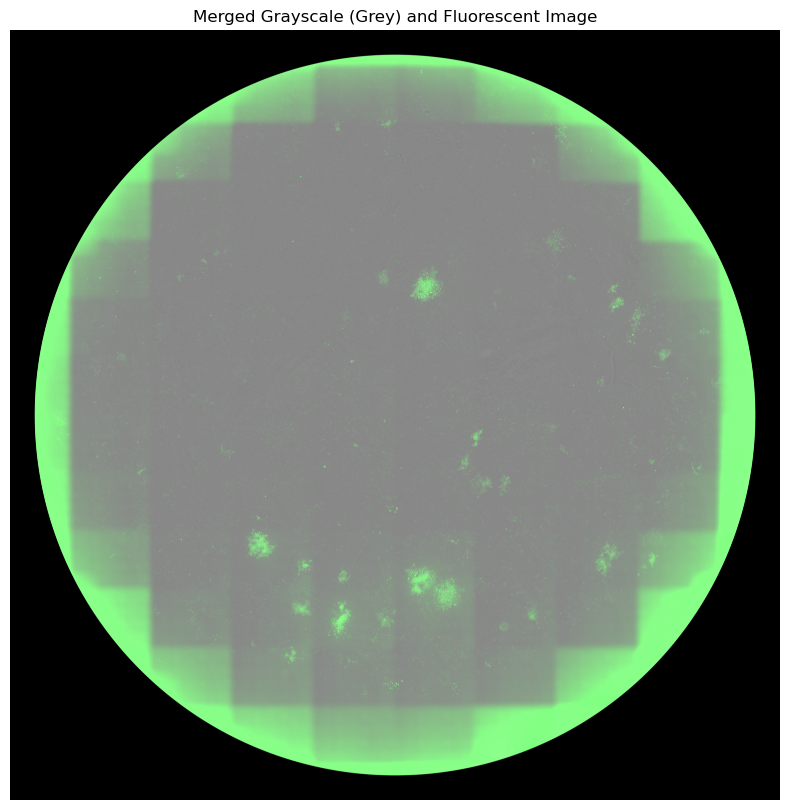

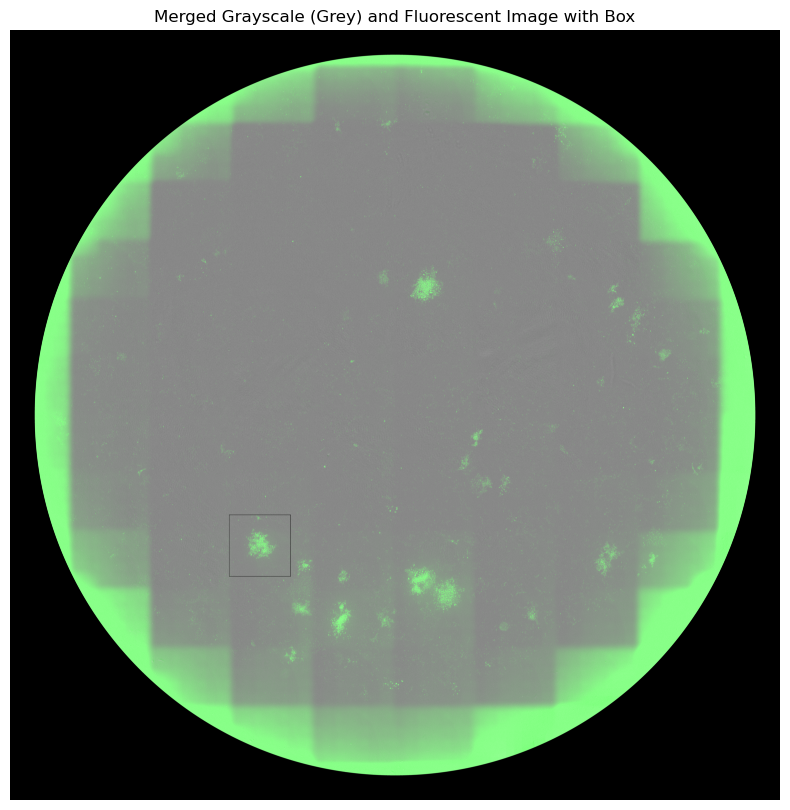

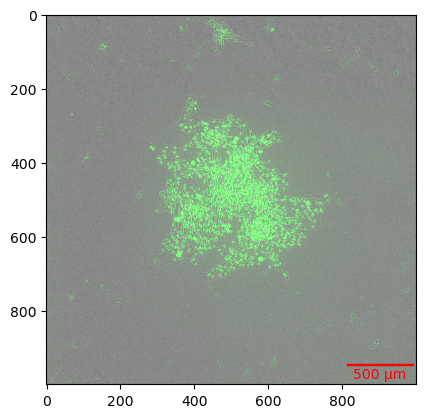

In [2]:
# Paths to the images
phase_image_path = Path(path_to_imgs + 'DLS083_Plate1_Phase_A1_1_30d00h00m.tif')
green_image_path = Path(path_to_imgs+'DLS083_Plate1_Green_A1_1_30d00h00m.tif')

# Read phase tiff using skimage
p1a1_phase = io.imread(phase_image_path)
h, w = p1a1_phase.shape
lum_im = Image.new('L', [w, h], 0)
draw = ImageDraw.Draw(lum_im)
draw.pieslice([(400, 400), (h - 400, w - 400)], 0, 360, fill=1)
lum_im_arr = np.asarray(lum_im)

# Rescale the intensity of the phase image
p1a1_phase_stretch = exposure.rescale_intensity(p1a1_phase, in_range=(120, 135), out_range='dtype').astype(np.float32)
# Cut the image and ensure background is zero
p1a1_phase_stretch_cut = p1a1_phase_stretch.copy()
p1a1_phase_stretch_cut[lum_im_arr == 0] = 0  # This line ensures background is zero

# Save the processed phase image
io.imsave('Plate1_WellA1_Phase.tif', p1a1_phase_stretch_cut.astype(np.float32))

# Read GFP tag tiff using skimage
p1a1_green = io.imread(green_image_path)
# Cut the image
p1a1_green_cut = p1a1_green.copy()
p1a1_green_cut[lum_im_arr == 0] = 0
# Rescale the intensity of the green image
p1a1_green_cut_stretch = exposure.rescale_intensity(p1a1_green_cut, in_range=(0, 100), out_range='dtype').astype(np.float32)

# Save the rescaled green image
io.imsave('Plate1_WellA1_Green.tif', p1a1_green_cut_stretch.astype(np.float32))

# Normalize images to range [0, 1]
p1a1_phase_stretch_cut_scale = exposure.rescale_intensity(p1a1_phase_stretch_cut, in_range='image', out_range=(0, 1))
p1a1_green_cut_stretch_scale = exposure.rescale_intensity(p1a1_green_cut_stretch, in_range='image', out_range=(0, 1))

# Create RGB version of grayscale image (grey)
grey_rgb_image = np.stack((p1a1_phase_stretch_cut_scale, p1a1_phase_stretch_cut_scale, p1a1_phase_stretch_cut_scale), axis=-1)

# Overlay the fluorescent image on top of the grey RGB image
# Assuming we want to overlay the fluorescent image in green channel
combined_image = grey_rgb_image.copy()
combined_image[..., 1] = np.maximum(grey_rgb_image[..., 1], p1a1_green_cut_stretch_scale)

# Display the result
plt.figure(figsize=(10, 10))
plt.imshow(combined_image)
plt.axis('off')
plt.title('Merged Grayscale (Grey) and Fluorescent Image')
plt.show()

# Save the combined image
tifffile.imwrite('Plate1_WellA1_merged.tif', (combined_image * 255).astype(np.uint8))

# Draw a box where the crop will be performed
rect_start = (4050 - 500, 8356 - 500)
rect_end = (4050 + 500, 8356 + 500)
rect_color = (1, 0, 0)  # Red color for the box

# Draw the rectangle on the combined image
combined_image_with_box = combined_image.copy()
combined_image_with_box = Image.fromarray((combined_image_with_box * 255).astype(np.uint8))
draw = ImageDraw.Draw(combined_image_with_box)
draw.rectangle([rect_start, rect_end], outline=rect_color, width=5)

# Display the result with the box
plt.figure(figsize=(10, 10))
plt.imshow(combined_image_with_box)
plt.axis('off')
plt.title('Merged Grayscale (Grey) and Fluorescent Image with Box')
plt.show()

# Save the combined image with the box
combined_image_with_box.save('Plate1_WellA1_merged_with_box.tif')

plt.imshow(combined_image, cmap = 'gray', vmin = 0, vmax = 1)
scalebar = AnchoredSizeBar(plt.gca().transData,
                           1798.561, '5 mm', 'lower right',
                           pad=0.1,
                           color='red',
                           frameon=False,
                           size_vertical=1)
plt.gca().add_artist(scalebar)
plt.savefig('Plate1_WellA1_merged_scale.tif')
plt.close()

# crop out a single clone
crop = combined_image[8356-500:8356+500,4050-500:4050+500]
tifffile.imwrite('Plate1_WellA1_merged_crop.tif', (crop * 255).astype(np.uint8))


plt.imshow(crop, cmap = 'gray', vmin = 0, vmax = 1)
scalebar = AnchoredSizeBar(plt.gca().transData,
                           179.8561, '500 µm', 'lower right',
                           pad=0.1,
                           color='red',
                           frameon=False,
                           size_vertical=1)
plt.gca().add_artist(scalebar)
plt.savefig('Plate1_WellA1_merged_crop_scale.tif')

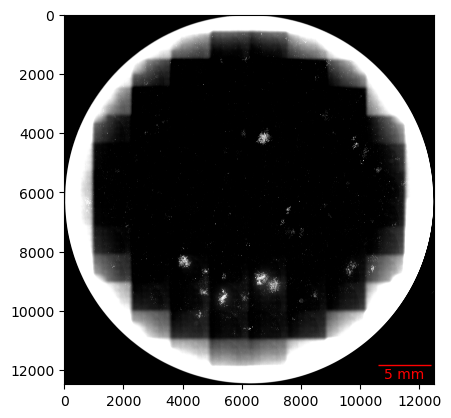

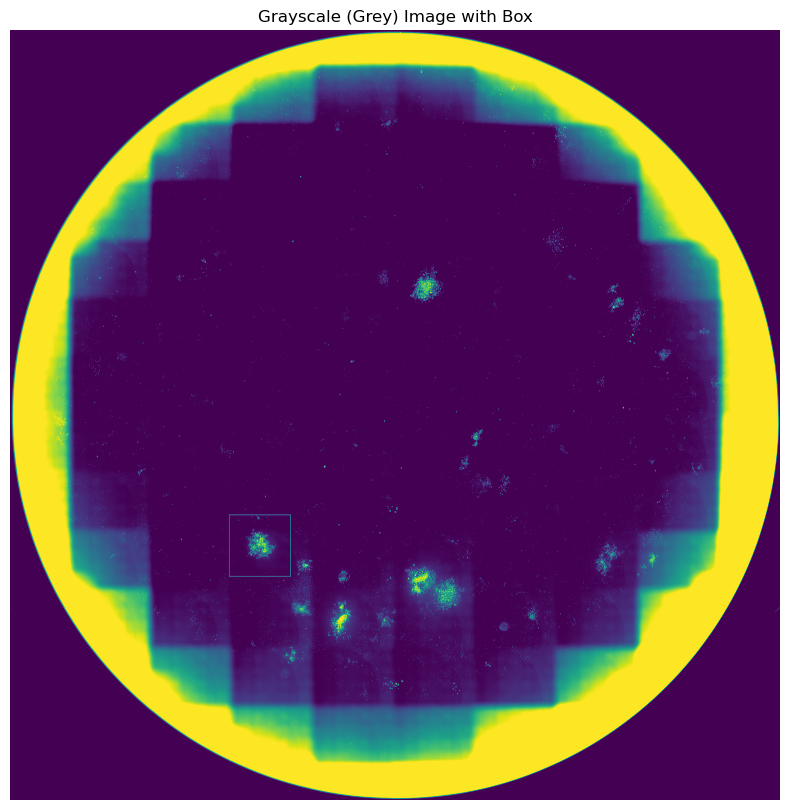

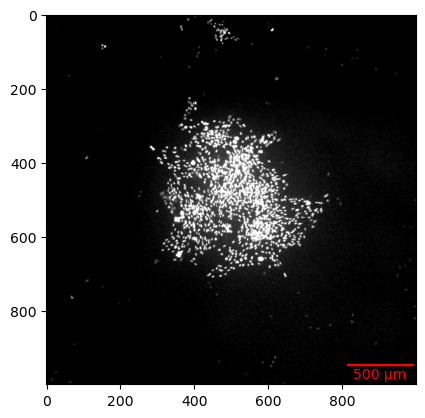

In [29]:
# Code for contrasting just the green image in greyscale
# read  tiff using skimage
green_image_path = Path(path_to_imgs+'DLS083_Plate1_Green_A1_1_30d00h00m.tif')
green_image = io.imread(green_image_path, as_gray=True).astype(np.float32)

# Rescale the intensity based on contrasting range
p1a1_green_stretch = exposure.rescale_intensity(green_image, in_range=(55,100), out_range='dtype').astype(np.float32)
plt.imshow(p1a1_green_stretch,cmap='gray', vmin=0, vmax=1)

scalebar = AnchoredSizeBar(plt.gca().transData,
                           1798.561, '5 mm', 'lower right',
                           pad=0.1,
                           color='red',
                           frameon=False,
                           size_vertical=1)
plt.gca().add_artist(scalebar)
plt.savefig('Plate1_A1_scalebar_Green_in_Grey.pdf')
plt.show()
# Save the full image 
io.imsave('Plate1_A1_Green_in_Grey.tif', p1a1_green_stretch)

# Draw a box where the crop will be performed
rect_start = (4050 - 500, 8356 - 500)
rect_end = (4050 + 500, 8356 + 500)
rect_color = (1, 0, 0)  # Red color for the box

# Draw the rectangle on the combined image
p1a1_green_stretch_with_box = p1a1_green_stretch.copy()
p1a1_green_stretch_with_box = Image.fromarray((p1a1_green_stretch_with_box * 255).astype(np.uint8))
draw = ImageDraw.Draw(p1a1_green_stretch_with_box)
draw.rectangle([rect_start, rect_end], outline='white', width=5)

# Display the result with the box
plt.figure(figsize=(10, 10))
plt.imshow(p1a1_green_stretch_with_box)
plt.axis('off')
plt.title('Grayscale (Grey) Image with Box')
plt.show()

# Save the combined image with the box
p1a1_green_stretch_with_box.save('Plate1_A1_Green_in_Grey_with_box.tif')

# crop out a single clone
crop = p1a1_green_stretch[8356-500:8356+500,4050-500:4050+500]
tifffile.imwrite('Plate1_A1_Green_in_Grey_crop.tif', (crop * 255).astype(np.uint8))


plt.imshow(crop, cmap = 'gray', vmin = 0, vmax = 1)
scalebar = AnchoredSizeBar(plt.gca().transData,
                           179.8561, '500 µm', 'lower right',
                           pad=0.1,
                           color='red',
                           frameon=False,
                           size_vertical=1)
plt.gca().add_artist(scalebar)
plt.savefig('Plate1_A1_Green_in_Grey_crop_scale.pdf')

Plate1 A2

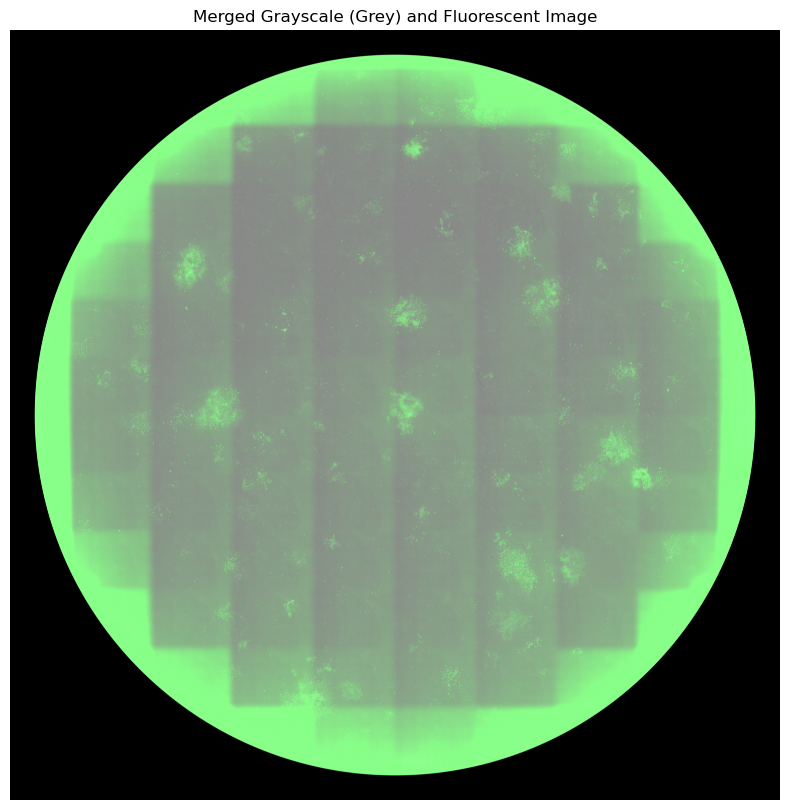

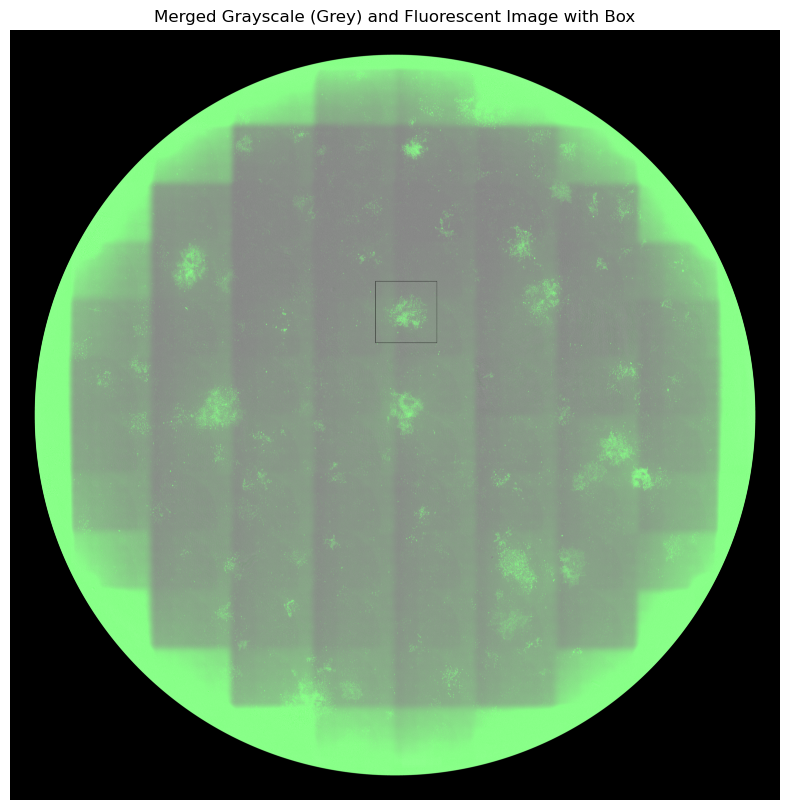

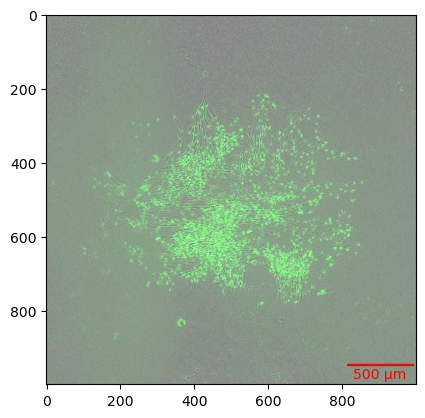

In [4]:
# Paths to the images
phase_image_path = Path(path_to_imgs + 'DLS083_Plate1_Phase_A2_1_30d00h00m.tif')
green_image_path = Path(path_to_imgs+'DLS083_Plate1_Green_A2_1_30d00h00m.tif')

# Read phase tiff using skimage
p1a1_phase = io.imread(phase_image_path)
h, w = p1a1_phase.shape
lum_im = Image.new('L', [w, h], 0)
draw = ImageDraw.Draw(lum_im)
draw.pieslice([(400, 400), (h - 400, w - 400)], 0, 360, fill=1)
lum_im_arr = np.asarray(lum_im)

# Rescale the intensity of the phase image
p1a1_phase_stretch = exposure.rescale_intensity(p1a1_phase, in_range=(120, 135), out_range='dtype').astype(np.float32)
# Cut the image and ensure background is zero
p1a1_phase_stretch_cut = p1a1_phase_stretch.copy()
p1a1_phase_stretch_cut[lum_im_arr == 0] = 0  # This line ensures background is zero

# Save the processed phase image
io.imsave('Plate1_WellA2_Phase.tif', p1a1_phase_stretch_cut.astype(np.float32))

# Read GFP tag tiff using skimage
p1a1_green = io.imread(green_image_path)
# Cut the image
p1a1_green_cut = p1a1_green.copy()
p1a1_green_cut[lum_im_arr == 0] = 0
# Rescale the intensity of the green image
p1a1_green_cut_stretch = exposure.rescale_intensity(p1a1_green_cut, in_range=(0, 80), out_range='dtype').astype(np.float32)

# Save the rescaled green image
io.imsave('Plate1_WellA2_Green.tif', p1a1_green_cut_stretch.astype(np.float32))

# Normalize images to range [0, 1]
p1a1_phase_stretch_cut_scale = exposure.rescale_intensity(p1a1_phase_stretch_cut, in_range='image', out_range=(0, 1))
p1a1_green_cut_stretch_scale = exposure.rescale_intensity(p1a1_green_cut_stretch, in_range='image', out_range=(0, 1))

# Create RGB version of grayscale image (grey)
grey_rgb_image = np.stack((p1a1_phase_stretch_cut_scale, p1a1_phase_stretch_cut_scale, p1a1_phase_stretch_cut_scale), axis=-1)

# Overlay the fluorescent image on top of the grey RGB image
# Assuming we want to overlay the fluorescent image in green channel
combined_image = grey_rgb_image.copy()
combined_image[..., 1] = np.maximum(grey_rgb_image[..., 1], p1a1_green_cut_stretch_scale)

# Display the result
plt.figure(figsize=(10, 10))
plt.imshow(combined_image)
plt.axis('off')
plt.title('Merged Grayscale (Grey) and Fluorescent Image')
plt.show()

# Save the combined image
tifffile.imwrite('Plate1_WellA2_merged.tif', (combined_image * 255).astype(np.uint8))

# Draw a box where the crop will be performed
rect_start = (6421 - 500, 4570 - 500)
rect_end = (6421 + 500, 4570 + 500)
rect_color = (1, 0, 0)  # Red color for the box

# Draw the rectangle on the combined image
combined_image_with_box = combined_image.copy()
combined_image_with_box = Image.fromarray((combined_image_with_box * 255).astype(np.uint8))
draw = ImageDraw.Draw(combined_image_with_box)
draw.rectangle([rect_start, rect_end], outline=rect_color, width=5)

# Display the result with the box
plt.figure(figsize=(10, 10))
plt.imshow(combined_image_with_box)
plt.axis('off')
plt.title('Merged Grayscale (Grey) and Fluorescent Image with Box')
plt.show()

# Save the combined image with the box
combined_image_with_box.save('Plate1_WellA2_merged_with_box.tif')

plt.imshow(combined_image, cmap = 'gray', vmin = 0, vmax = 1)
scalebar = AnchoredSizeBar(plt.gca().transData,
                           1798.561, '5 mm', 'lower right',
                           pad=0.1,
                           color='red',
                           frameon=False,
                           size_vertical=1)
plt.gca().add_artist(scalebar)
plt.savefig('Plate1_WellA2_merged_scale.tif')
plt.close()

# crop out a single clone
crop = combined_image[4570-500:4570+500,6421-500:6421+500]
tifffile.imwrite('Plate1_WellA2_merged_crop.tif', (crop * 255).astype(np.uint8))


plt.imshow(crop, cmap = 'gray', vmin = 0, vmax = 1)
scalebar = AnchoredSizeBar(plt.gca().transData,
                           179.8561, '500 µm', 'lower right',
                           pad=0.1,
                           color='red',
                           frameon=False,
                           size_vertical=1)
plt.gca().add_artist(scalebar)
plt.savefig('Plate1_WellA2_merged_crop_scale.tif')

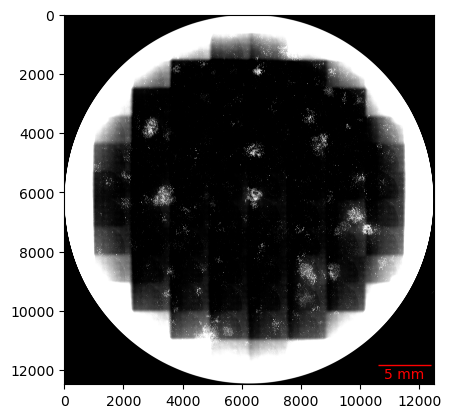

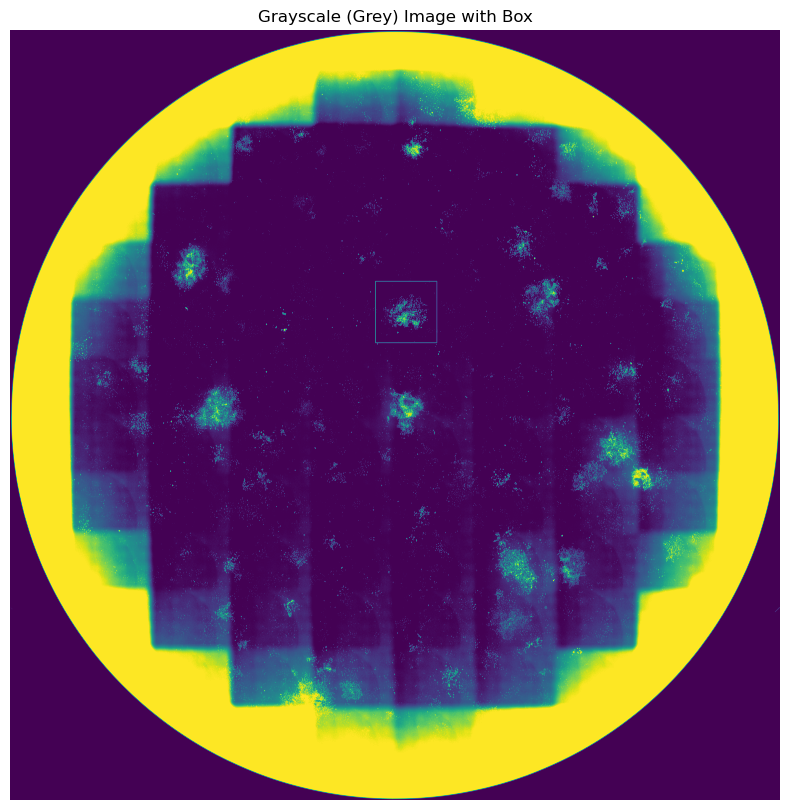

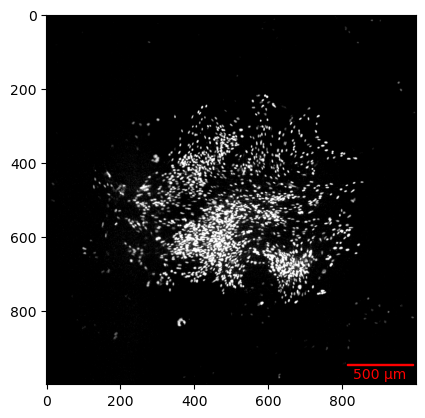

In [5]:
# Code for contrasting just the green image in greyscale
# read  tiff using skimage
green_image_path = Path(path_to_imgs+'DLS083_Plate1_Green_A2_1_30d00h00m.tif')
green_image = io.imread(green_image_path, as_gray=True).astype(np.float32)

# Rescale the intensity based on contrasting range
p1a2_green_stretch = exposure.rescale_intensity(green_image, in_range=(50,75), out_range='dtype').astype(np.float32)
plt.imshow(p1a2_green_stretch,cmap='gray', vmin=0, vmax=1)

scalebar = AnchoredSizeBar(plt.gca().transData,
                           1798.561, '5 mm', 'lower right',
                           pad=0.1,
                           color='red',
                           frameon=False,
                           size_vertical=1)
plt.gca().add_artist(scalebar)
plt.savefig('Plate1_A2_scalebar_Green_in_Grey.pdf')
plt.show()
# Save the full image 
io.imsave('Plate1_A2_Green_in_Grey.tif', p1a2_green_stretch)

# Draw a box where the crop will be performed
rect_start = (6421 - 500, 4570 - 500)
rect_end = (6421 + 500, 4570 + 500)
rect_color = (1, 0, 0)  # Red color for the box

# Draw the rectangle on the combined image
p1a2_green_stretch_with_box = p1a2_green_stretch.copy()
p1a2_green_stretch_with_box = Image.fromarray((p1a2_green_stretch_with_box * 255).astype(np.uint8))
draw = ImageDraw.Draw(p1a2_green_stretch_with_box)
draw.rectangle([rect_start, rect_end], outline='white', width=5)

# Display the result with the box
plt.figure(figsize=(10, 10))
plt.imshow(p1a2_green_stretch_with_box)
plt.axis('off')
plt.title('Grayscale (Grey) Image with Box')
plt.show()

# Save the combined image with the box
p1a2_green_stretch_with_box.save('Plate1_A2_Green_in_Grey_with_box.tif')

# crop out a single clone
crop = p1a2_green_stretch[4570-500:4570+500,6421-500:6421+500]
tifffile.imwrite('Plate1_A2_Green_in_Grey_crop.tif', (crop * 255).astype(np.uint8))


plt.imshow(crop, cmap = 'gray', vmin = 0, vmax = 1)
scalebar = AnchoredSizeBar(plt.gca().transData,
                           179.8561, '500 µm', 'lower right',
                           pad=0.1,
                           color='red',
                           frameon=False,
                           size_vertical=1)
plt.gca().add_artist(scalebar)
plt.savefig('Plate1_A2_Green_in_Grey_crop_scale.pdf')

Plate1 A3

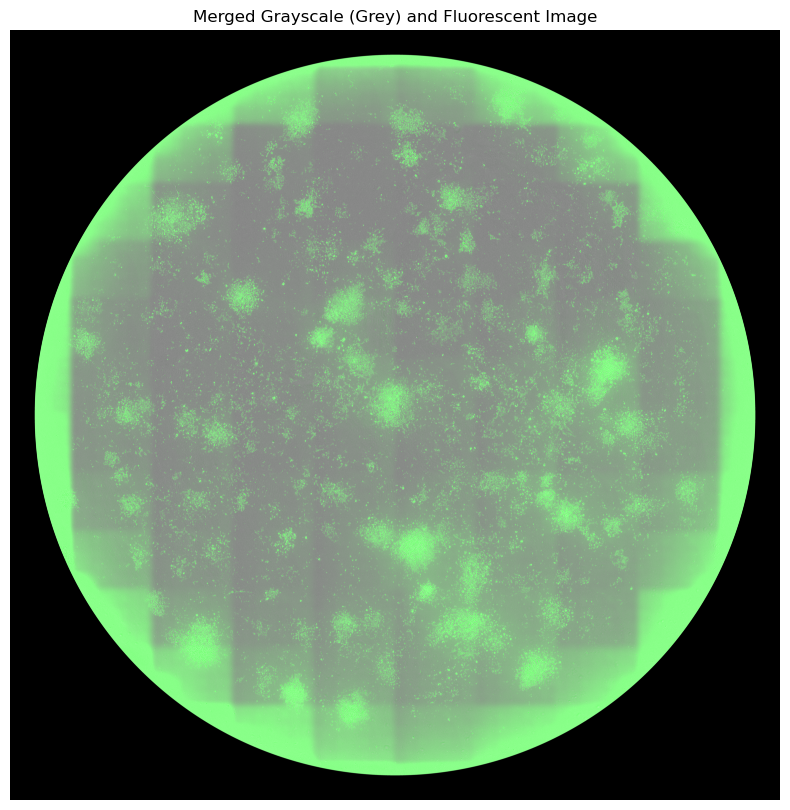

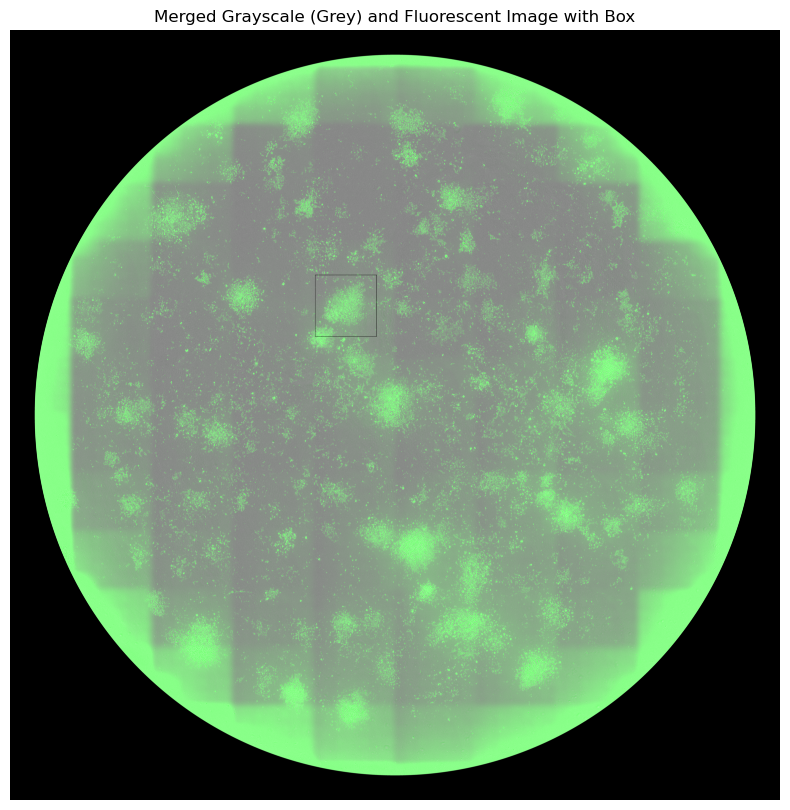

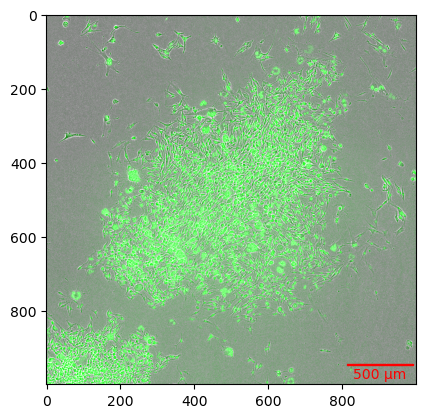

In [6]:
# Paths to the images
phase_image_path = Path(path_to_imgs + 'DLS083_Plate1_Phase_A3_1_30d00h00m.tif')
green_image_path = Path(path_to_imgs+'DLS083_Plate1_Green_A3_1_30d00h00m.tif')

# Read phase tiff using skimage
p1a1_phase = io.imread(phase_image_path)
h, w = p1a1_phase.shape
lum_im = Image.new('L', [w, h], 0)
draw = ImageDraw.Draw(lum_im)
draw.pieslice([(400, 400), (h - 400, w - 400)], 0, 360, fill=1)
lum_im_arr = np.asarray(lum_im)

# Rescale the intensity of the phase image
p1a1_phase_stretch = exposure.rescale_intensity(p1a1_phase, in_range=(120, 135), out_range='dtype').astype(np.float32)
# Cut the image and ensure background is zero
p1a1_phase_stretch_cut = p1a1_phase_stretch.copy()
p1a1_phase_stretch_cut[lum_im_arr == 0] = 0  # This line ensures background is zero

# Save the processed phase image
io.imsave('Plate1_WellA3_Phase.tif', p1a1_phase_stretch_cut.astype(np.float32))

# Read GFP tag tiff using skimage
p1a1_green = io.imread(green_image_path)
# Cut the image
p1a1_green_cut = p1a1_green.copy()
p1a1_green_cut[lum_im_arr == 0] = 0
# Rescale the intensity of the green image
p1a1_green_cut_stretch = exposure.rescale_intensity(p1a1_green_cut, in_range=(0, 100), out_range='dtype').astype(np.float32)

# Save the rescaled green image
io.imsave('Plate1_WellA3_Green.tif', p1a1_green_cut_stretch.astype(np.float32))

# Normalize images to range [0, 1]
p1a1_phase_stretch_cut_scale = exposure.rescale_intensity(p1a1_phase_stretch_cut, in_range='image', out_range=(0, 1))
p1a1_green_cut_stretch_scale = exposure.rescale_intensity(p1a1_green_cut_stretch, in_range='image', out_range=(0, 1))

# Create RGB version of grayscale image (grey)
grey_rgb_image = np.stack((p1a1_phase_stretch_cut_scale, p1a1_phase_stretch_cut_scale, p1a1_phase_stretch_cut_scale), axis=-1)

# Overlay the fluorescent image on top of the grey RGB image
# Assuming we want to overlay the fluorescent image in green channel
combined_image = grey_rgb_image.copy()
combined_image[..., 1] = np.maximum(grey_rgb_image[..., 1], p1a1_green_cut_stretch_scale)

# Display the result
plt.figure(figsize=(10, 10))
plt.imshow(combined_image)
plt.axis('off')
plt.title('Merged Grayscale (Grey) and Fluorescent Image')
plt.show()

# Save the combined image
tifffile.imwrite('Plate1_WellA3_merged.tif', (combined_image * 255).astype(np.uint8))

# Draw a box where the crop will be performed
rect_start = (5444 - 500, 4468 - 500)
rect_end = (5444 + 500, 4468 + 500)
rect_color = (1, 0, 0)  # Red color for the box

# Draw the rectangle on the combined image
combined_image_with_box = combined_image.copy()
combined_image_with_box = Image.fromarray((combined_image_with_box * 255).astype(np.uint8))
draw = ImageDraw.Draw(combined_image_with_box)
draw.rectangle([rect_start, rect_end], outline=rect_color, width=5)

# Display the result with the box
plt.figure(figsize=(10, 10))
plt.imshow(combined_image_with_box)
plt.axis('off')
plt.title('Merged Grayscale (Grey) and Fluorescent Image with Box')
plt.show()

# Save the combined image with the box
combined_image_with_box.save('Plate1_WellA3_merged_with_box.tif')

plt.imshow(combined_image, cmap = 'gray', vmin = 0, vmax = 1)
scalebar = AnchoredSizeBar(plt.gca().transData,
                           1798.561, '5 mm', 'lower right',
                           pad=0.1,
                           color='red',
                           frameon=False,
                           size_vertical=1)
plt.gca().add_artist(scalebar)
plt.savefig('Plate1_WellA3_merged_scale.tif')
plt.close()

# crop out a single clone
crop = combined_image[4468-500:4468+500,5444-500:5444+500]
tifffile.imwrite('Plate1_WellA3_merged_crop.tif', (crop * 255).astype(np.uint8))


plt.imshow(crop, cmap = 'gray', vmin = 0, vmax = 1)
scalebar = AnchoredSizeBar(plt.gca().transData,
                           179.8561, '500 µm', 'lower right',
                           pad=0.1,
                           color='red',
                           frameon=False,
                           size_vertical=1)
plt.gca().add_artist(scalebar)
plt.savefig('Plate1_WellA3_merged_crop_scale.tif')

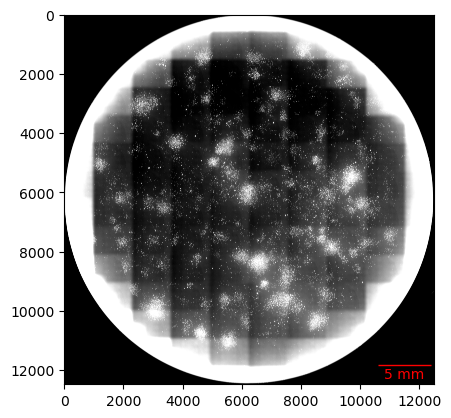

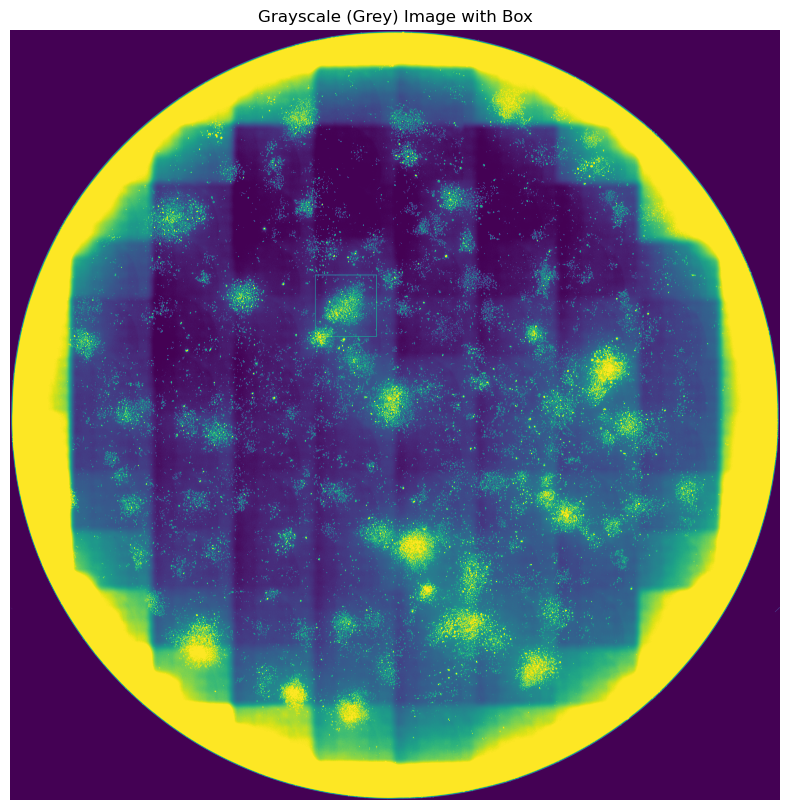

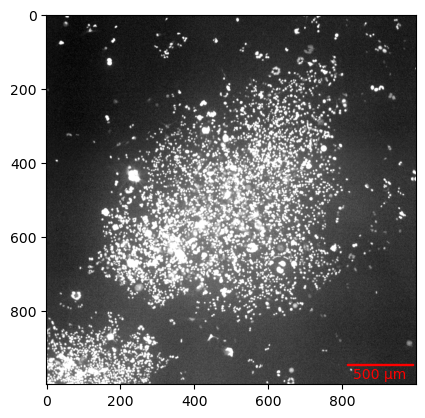

In [7]:
# Code for contrasting just the green image in greyscale
# read  tiff using skimage
green_image_path = Path(path_to_imgs+'DLS083_Plate1_Green_A3_1_30d00h00m.tif')
green_image = io.imread(green_image_path, as_gray=True).astype(np.float32)

# Rescale the intensity based on contrasting range
p1a3_green_stretch = exposure.rescale_intensity(green_image, in_range=(50,100), out_range='dtype').astype(np.float32)
plt.imshow(p1a3_green_stretch,cmap='gray', vmin=0, vmax=1)

scalebar = AnchoredSizeBar(plt.gca().transData,
                           1798.561, '5 mm', 'lower right',
                           pad=0.1,
                           color='red',
                           frameon=False,
                           size_vertical=1)
plt.gca().add_artist(scalebar)
plt.savefig('Plate1_A3_scalebar_Green_in_Grey.pdf')
plt.show()
# Save the full image 
io.imsave('Plate1_A3_Green_in_Grey.tif', p1a3_green_stretch)

# Draw a box where the crop will be performed
rect_start = (5444 - 500, 4468 - 500)
rect_end = (5444 + 500, 4468 + 500)
rect_color = (1, 0, 0)  # Red color for the box

# Draw the rectangle on the combined image
p1a3_green_stretch_with_box = p1a3_green_stretch.copy()
p1a3_green_stretch_with_box = Image.fromarray((p1a3_green_stretch_with_box * 255).astype(np.uint8))
draw = ImageDraw.Draw(p1a3_green_stretch_with_box)
draw.rectangle([rect_start, rect_end], outline='white', width=5)

# Display the result with the box
plt.figure(figsize=(10, 10))
plt.imshow(p1a3_green_stretch_with_box)
plt.axis('off')
plt.title('Grayscale (Grey) Image with Box')
plt.show()

# Save the combined image with the box
p1a3_green_stretch_with_box.save('Plate1_A3_Green_in_Grey_with_box.tif')

# crop out a single clone
crop = p1a3_green_stretch[4468-500:4468+500,5444-500:5444+500]
tifffile.imwrite('Plate1_A3_Green_in_Grey_crop.tif', (crop * 255).astype(np.uint8))


plt.imshow(crop, cmap = 'gray', vmin = 0, vmax = 1)
scalebar = AnchoredSizeBar(plt.gca().transData,
                           179.8561, '500 µm', 'lower right',
                           pad=0.1,
                           color='red',
                           frameon=False,
                           size_vertical=1)
plt.gca().add_artist(scalebar)
plt.savefig('Plate1_A3_Green_in_Grey_crop_scale.pdf')

Plate1 B1


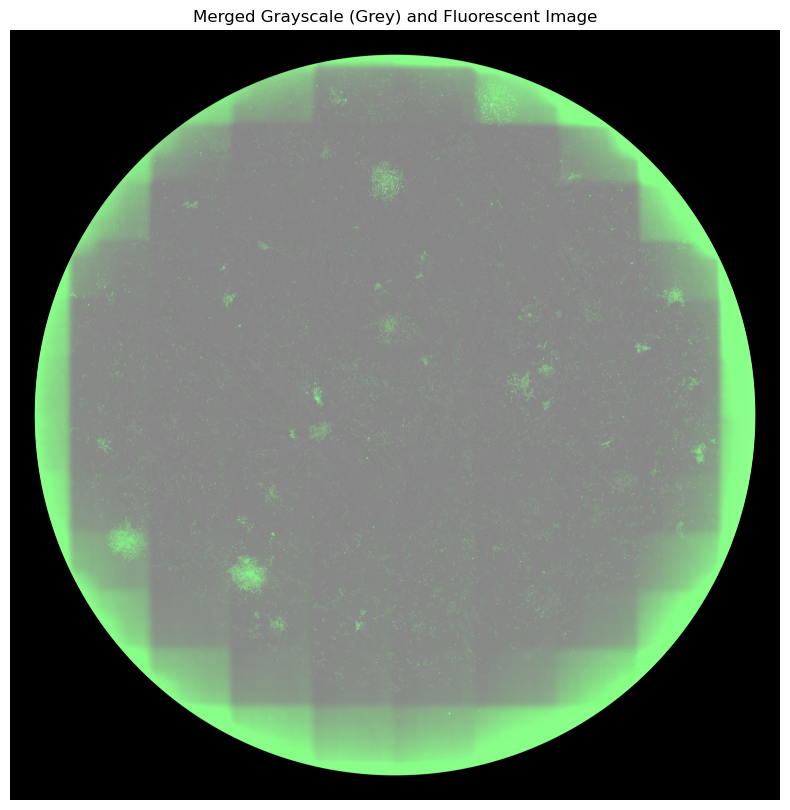

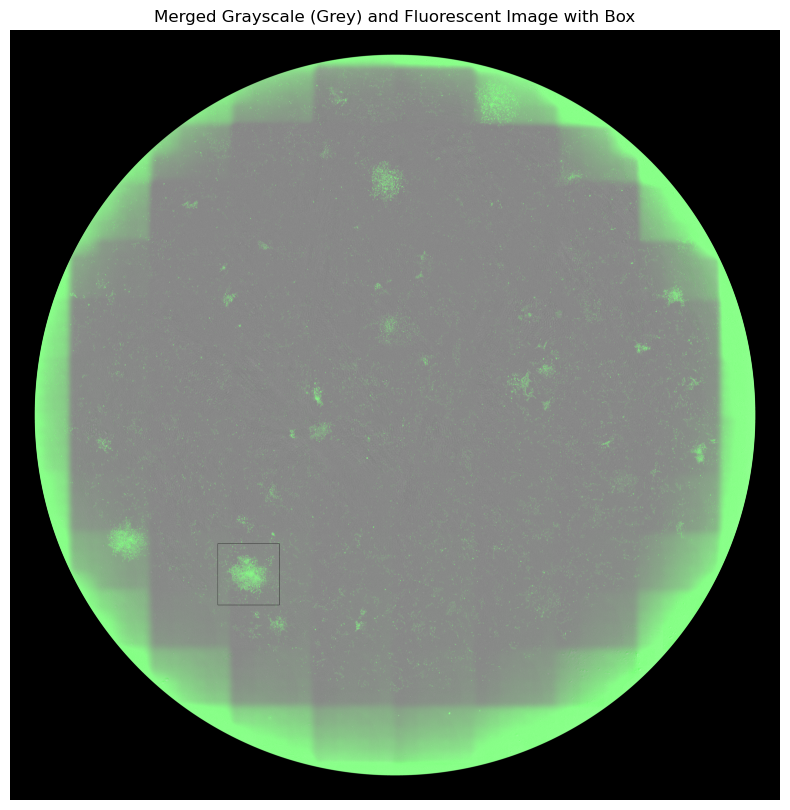

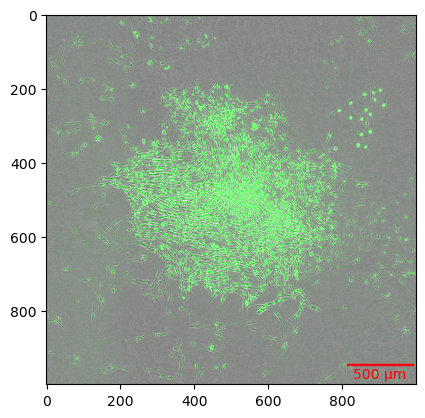

In [8]:
# Paths to the images
phase_image_path = Path(path_to_imgs + 'DLS083_Plate1_Phase_B1_1_30d00h00m.tif')
green_image_path = Path(path_to_imgs+'DLS083_Plate1_Green_B1_1_30d00h00m.tif')

# Read phase tiff using skimage
p1a1_phase = io.imread(phase_image_path)
h, w = p1a1_phase.shape
lum_im = Image.new('L', [w, h], 0)
draw = ImageDraw.Draw(lum_im)
draw.pieslice([(400, 400), (h - 400, w - 400)], 0, 360, fill=1)
lum_im_arr = np.asarray(lum_im)

# Rescale the intensity of the phase image
p1a1_phase_stretch = exposure.rescale_intensity(p1a1_phase, in_range=(120, 135), out_range='dtype').astype(np.float32)
# Cut the image and ensure background is zero
p1a1_phase_stretch_cut = p1a1_phase_stretch.copy()
p1a1_phase_stretch_cut[lum_im_arr == 0] = 0  # This line ensures background is zero

# Save the processed phase image
io.imsave('Plate1_WellB1_Phase.tif', p1a1_phase_stretch_cut.astype(np.float32))

# Read GFP tag tiff using skimage
p1a1_green = io.imread(green_image_path)
# Cut the image
p1a1_green_cut = p1a1_green.copy()
p1a1_green_cut[lum_im_arr == 0] = 0
# Rescale the intensity of the green image
p1a1_green_cut_stretch = exposure.rescale_intensity(p1a1_green_cut, in_range=(0, 100), out_range='dtype').astype(np.float32)

# Save the rescaled green image
io.imsave('Plate1_WellB1_Green.tif', p1a1_green_cut_stretch.astype(np.float32))

# Normalize images to range [0, 1]
p1a1_phase_stretch_cut_scale = exposure.rescale_intensity(p1a1_phase_stretch_cut, in_range='image', out_range=(0, 1))
p1a1_green_cut_stretch_scale = exposure.rescale_intensity(p1a1_green_cut_stretch, in_range='image', out_range=(0, 1))

# Create RGB version of grayscale image (grey)
grey_rgb_image = np.stack((p1a1_phase_stretch_cut_scale, p1a1_phase_stretch_cut_scale, p1a1_phase_stretch_cut_scale), axis=-1)

# Overlay the fluorescent image on top of the grey RGB image
# Assuming we want to overlay the fluorescent image in green channel
combined_image = grey_rgb_image.copy()
combined_image[..., 1] = np.maximum(grey_rgb_image[..., 1], p1a1_green_cut_stretch_scale)

# Display the result
plt.figure(figsize=(10, 10))
plt.imshow(combined_image)
plt.axis('off')
plt.title('Merged Grayscale (Grey) and Fluorescent Image')
plt.show()

# Save the combined image
tifffile.imwrite('Plate1_WellB1_merged.tif', (combined_image * 255).astype(np.uint8))

# Draw a box where the crop will be performed
rect_start = (3866 - 500, 8821 - 500)
rect_end = (3866 + 500, 8821 + 500)
rect_color = (1, 0, 0)  # Red color for the box

# Draw the rectangle on the combined image
combined_image_with_box = combined_image.copy()
combined_image_with_box = Image.fromarray((combined_image_with_box * 255).astype(np.uint8))
draw = ImageDraw.Draw(combined_image_with_box)
draw.rectangle([rect_start, rect_end], outline=rect_color, width=5)

# Display the result with the box
plt.figure(figsize=(10, 10))
plt.imshow(combined_image_with_box)
plt.axis('off')
plt.title('Merged Grayscale (Grey) and Fluorescent Image with Box')
plt.show()

# Save the combined image with the box
combined_image_with_box.save('Plate1_WellB1_merged_with_box.tif')

plt.imshow(combined_image, cmap = 'gray', vmin = 0, vmax = 1)
scalebar = AnchoredSizeBar(plt.gca().transData,
                           1798.561, '5 mm', 'lower right',
                           pad=0.1,
                           color='red',
                           frameon=False,
                           size_vertical=1)
plt.gca().add_artist(scalebar)
plt.savefig('Plate1_WellB1_merged_scale.tif')
plt.close()

# crop out a single clone
crop = combined_image[8821-500:8821+500,3866-500:3866+500]
tifffile.imwrite('Plate1_WellB1_merged_crop.tif', (crop * 255).astype(np.uint8))


plt.imshow(crop, cmap = 'gray', vmin = 0, vmax = 1)
scalebar = AnchoredSizeBar(plt.gca().transData,
                           179.8561, '500 µm', 'lower right',
                           pad=0.1,
                           color='red',
                           frameon=False,
                           size_vertical=1)
plt.gca().add_artist(scalebar)
plt.savefig('Plate1_WellB1_merged_crop_scale.tif')

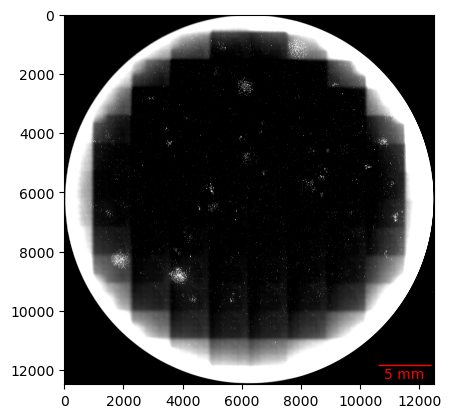

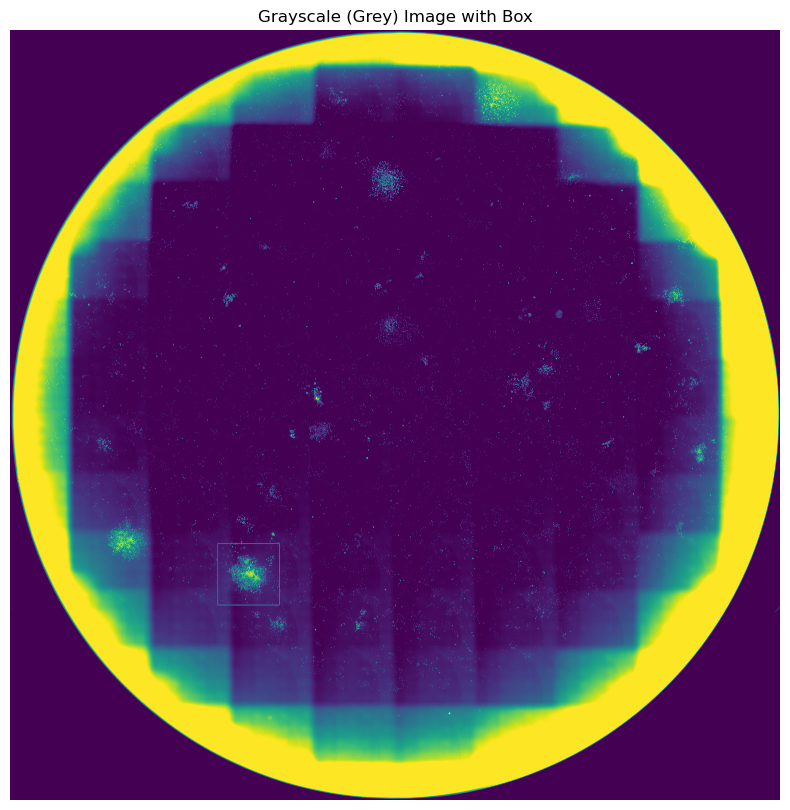

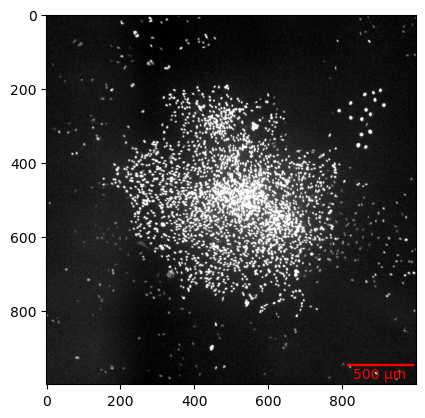

In [9]:
# Code for contrasting just the green image in greyscale
# read  tiff using skimage
green_image_path = Path(path_to_imgs+'DLS083_Plate1_Green_B1_1_30d00h00m.tif')
green_image = io.imread(green_image_path, as_gray=True).astype(np.float32)

# Rescale the intensity based on contrasting range
p1b1_green_stretch = exposure.rescale_intensity(green_image, in_range=(50,100), out_range='dtype').astype(np.float32)
plt.imshow(p1b1_green_stretch,cmap='gray', vmin=0, vmax=1)

scalebar = AnchoredSizeBar(plt.gca().transData,
                           1798.561, '5 mm', 'lower right',
                           pad=0.1,
                           color='red',
                           frameon=False,
                           size_vertical=1)
plt.gca().add_artist(scalebar)
plt.savefig('Plate1_B1_scalebar_Green_in_Grey.pdf')
plt.show()
# Save the full image 
io.imsave('Plate1_B1_Green_in_Grey.tif', p1b1_green_stretch)

# Draw a box where the crop will be performed
rect_start = (3866 - 500, 8821 - 500)
rect_end = (3866 + 500, 8821 + 500)
rect_color = (1, 0, 0)  # Red color for the box

# Draw the rectangle on the combined image
p1b1_green_stretch_with_box = p1b1_green_stretch.copy()
p1b1_green_stretch_with_box = Image.fromarray((p1b1_green_stretch_with_box * 255).astype(np.uint8))
draw = ImageDraw.Draw(p1b1_green_stretch_with_box)
draw.rectangle([rect_start, rect_end], outline='white', width=5)

# Display the result with the box
plt.figure(figsize=(10, 10))
plt.imshow(p1b1_green_stretch_with_box)
plt.axis('off')
plt.title('Grayscale (Grey) Image with Box')
plt.show()

# Save the combined image with the box
p1b1_green_stretch_with_box.save('Plate1_B1_Green_in_Grey_with_box.tif')

# crop out a single clone
crop = p1b1_green_stretch[8821-500:8821+500,3866-500:3866+500]
tifffile.imwrite('Plate1_B1_Green_in_Grey_crop.tif', (crop * 255).astype(np.uint8))


plt.imshow(crop, cmap = 'gray', vmin = 0, vmax = 1)
scalebar = AnchoredSizeBar(plt.gca().transData,
                           179.8561, '500 µm', 'lower right',
                           pad=0.1,
                           color='red',
                           frameon=False,
                           size_vertical=1)
plt.gca().add_artist(scalebar)
plt.savefig('Plate1_B1_Green_in_Grey_crop_scale.pdf')

Plate1 B2

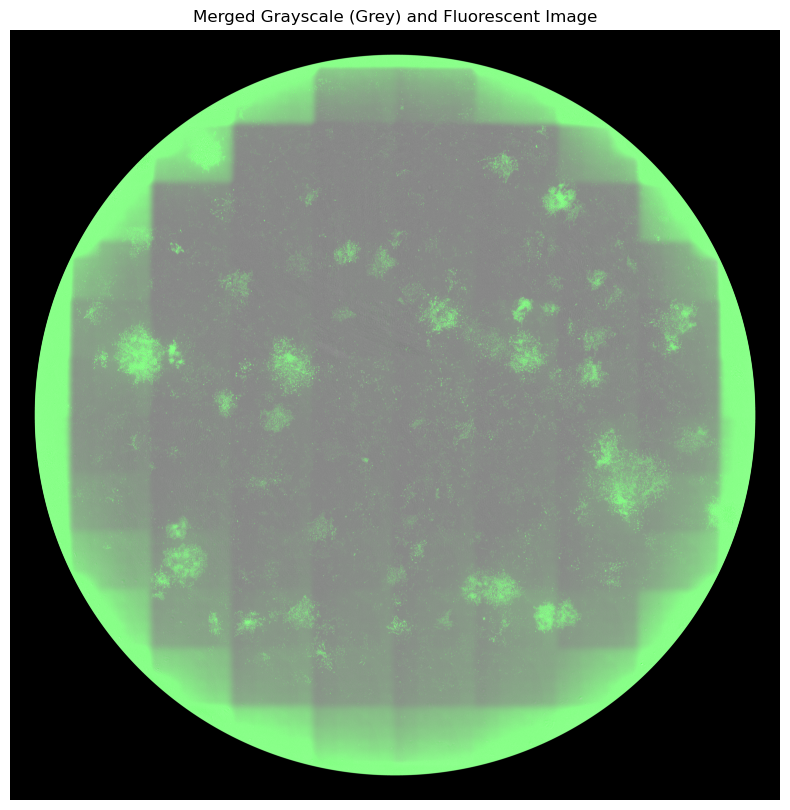

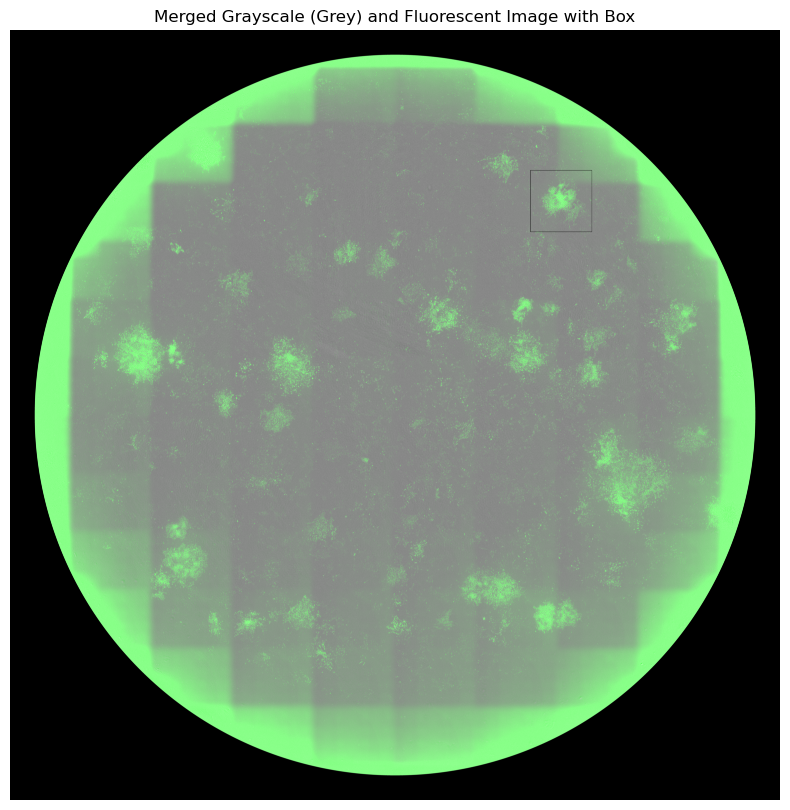

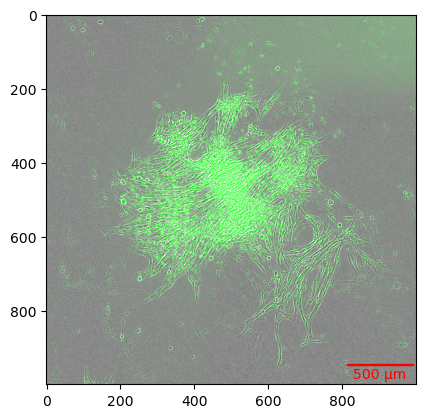

In [10]:
# Paths to the images
phase_image_path = Path(path_to_imgs + 'DLS083_Plate1_Phase_B2_1_30d00h00m.tif')
green_image_path = Path(path_to_imgs+'DLS083_Plate1_Green_B2_1_30d00h00m.tif')

# Read phase tiff using skimage
p1a1_phase = io.imread(phase_image_path)
h, w = p1a1_phase.shape
lum_im = Image.new('L', [w, h], 0)
draw = ImageDraw.Draw(lum_im)
draw.pieslice([(400, 400), (h - 400, w - 400)], 0, 360, fill=1)
lum_im_arr = np.asarray(lum_im)

# Rescale the intensity of the phase image
p1a1_phase_stretch = exposure.rescale_intensity(p1a1_phase, in_range=(120, 135), out_range='dtype').astype(np.float32)
# Cut the image and ensure background is zero
p1a1_phase_stretch_cut = p1a1_phase_stretch.copy()
p1a1_phase_stretch_cut[lum_im_arr == 0] = 0  # This line ensures background is zero

# Save the processed phase image
io.imsave('Plate1_WellB2_Phase.tif', p1a1_phase_stretch_cut.astype(np.float32))

# Read GFP tag tiff using skimage
p1a1_green = io.imread(green_image_path)
# Cut the image
p1a1_green_cut = p1a1_green.copy()
p1a1_green_cut[lum_im_arr == 0] = 0
# Rescale the intensity of the green image
p1a1_green_cut_stretch = exposure.rescale_intensity(p1a1_green_cut, in_range=(0, 90), out_range='dtype').astype(np.float32)

# Save the rescaled green image
io.imsave('Plate1_WellB2_Green.tif', p1a1_green_cut_stretch.astype(np.float32))

# Normalize images to range [0, 1]
p1a1_phase_stretch_cut_scale = exposure.rescale_intensity(p1a1_phase_stretch_cut, in_range='image', out_range=(0, 1))
p1a1_green_cut_stretch_scale = exposure.rescale_intensity(p1a1_green_cut_stretch, in_range='image', out_range=(0, 1))

# Create RGB version of grayscale image (grey)
grey_rgb_image = np.stack((p1a1_phase_stretch_cut_scale, p1a1_phase_stretch_cut_scale, p1a1_phase_stretch_cut_scale), axis=-1)

# Overlay the fluorescent image on top of the grey RGB image
# Assuming we want to overlay the fluorescent image in green channel
combined_image = grey_rgb_image.copy()
combined_image[..., 1] = np.maximum(grey_rgb_image[..., 1], p1a1_green_cut_stretch_scale)

# Display the result
plt.figure(figsize=(10, 10))
plt.imshow(combined_image)
plt.axis('off')
plt.title('Merged Grayscale (Grey) and Fluorescent Image')
plt.show()

# Save the combined image
tifffile.imwrite('Plate1_WellB2_merged.tif', (combined_image * 255).astype(np.uint8))

# Draw a box where the crop will be performed
rect_start = (8933 - 500, 2772 - 500)
rect_end = (8933 + 500, 2772 + 500)
rect_color = (1, 0, 0)  # Red color for the box

# Draw the rectangle on the combined image
combined_image_with_box = combined_image.copy()
combined_image_with_box = Image.fromarray((combined_image_with_box * 255).astype(np.uint8))
draw = ImageDraw.Draw(combined_image_with_box)
draw.rectangle([rect_start, rect_end], outline=rect_color, width=5)

# Display the result with the box
plt.figure(figsize=(10, 10))
plt.imshow(combined_image_with_box)
plt.axis('off')
plt.title('Merged Grayscale (Grey) and Fluorescent Image with Box')
plt.show()

# Save the combined image with the box
combined_image_with_box.save('Plate1_WellB2_merged_with_box.tif')

plt.imshow(combined_image, cmap = 'gray', vmin = 0, vmax = 1)
scalebar = AnchoredSizeBar(plt.gca().transData,
                           1798.561, '5 mm', 'lower right',
                           pad=0.1,
                           color='red',
                           frameon=False,
                           size_vertical=1)
plt.gca().add_artist(scalebar)
plt.savefig('Plate1_WellB2_merged_scale.tif')
plt.close()

# crop out a single clone
crop = combined_image[2772-500:2772+500,8933-500:8933+500]
tifffile.imwrite('Plate1_WellB2_merged_crop.tif', (crop * 255).astype(np.uint8))


plt.imshow(crop, cmap = 'gray', vmin = 0, vmax = 1)
scalebar = AnchoredSizeBar(plt.gca().transData,
                           179.8561, '500 µm', 'lower right',
                           pad=0.1,
                           color='red',
                           frameon=False,
                           size_vertical=1)
plt.gca().add_artist(scalebar)
plt.savefig('Plate1_WellB2_merged_crop_scale.tif')

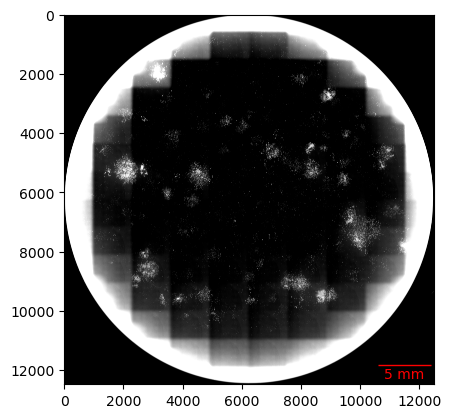

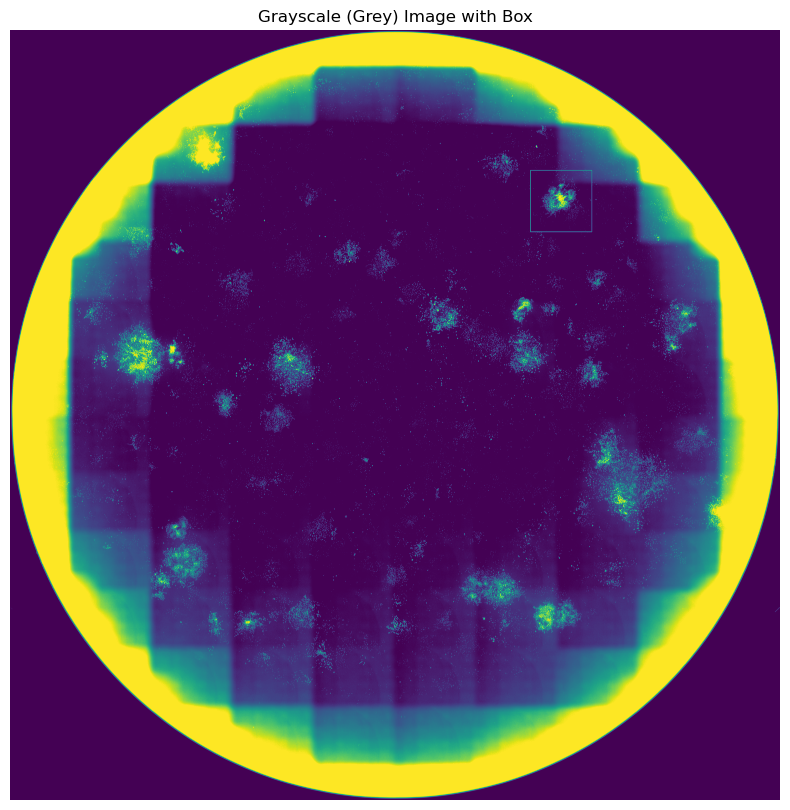

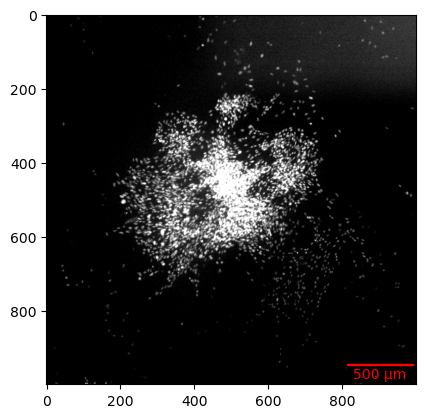

In [11]:
# Code for contrasting just the green image in greyscale
# read  tiff using skimage
green_image_path = Path(path_to_imgs+'DLS083_Plate1_Green_B2_1_30d00h00m.tif')
green_image = io.imread(green_image_path, as_gray=True).astype(np.float32)

# Rescale the intensity based on contrasting range
p1b2_green_stretch = exposure.rescale_intensity(green_image, in_range=(50,100), out_range='dtype').astype(np.float32)
plt.imshow(p1b2_green_stretch,cmap='gray', vmin=0, vmax=1)

scalebar = AnchoredSizeBar(plt.gca().transData,
                           1798.561, '5 mm', 'lower right',
                           pad=0.1,
                           color='red',
                           frameon=False,
                           size_vertical=1)
plt.gca().add_artist(scalebar)
plt.savefig('Plate1_B2_scalebar_Green_in_Grey.pdf')
plt.show()
# Save the full image 
io.imsave('Plate1_B2_Green_in_Grey.tif', p1b2_green_stretch)

# Draw a box where the crop will be performed
rect_start = (8933 - 500, 2772 - 500)
rect_end = (8933 + 500, 2772 + 500)
rect_color = (1, 0, 0)  # Red color for the box

# Draw the rectangle on the combined image
p1b2_green_stretch_with_box = p1b2_green_stretch.copy()
p1b2_green_stretch_with_box = Image.fromarray((p1b2_green_stretch_with_box * 255).astype(np.uint8))
draw = ImageDraw.Draw(p1b2_green_stretch_with_box)
draw.rectangle([rect_start, rect_end], outline='white', width=5)

# Display the result with the box
plt.figure(figsize=(10, 10))
plt.imshow(p1b2_green_stretch_with_box)
plt.axis('off')
plt.title('Grayscale (Grey) Image with Box')
plt.show()

# Save the combined image with the box
p1b2_green_stretch_with_box.save('Plate1_B2_Green_in_Grey_with_box.tif')

# crop out a single clone
crop = p1b2_green_stretch[2772-500:2772+500,8933-500:8933+500]
tifffile.imwrite('Plate1_B2_Green_in_Grey_crop.tif', (crop * 255).astype(np.uint8))


plt.imshow(crop, cmap = 'gray', vmin = 0, vmax = 1)
scalebar = AnchoredSizeBar(plt.gca().transData,
                           179.8561, '500 µm', 'lower right',
                           pad=0.1,
                           color='red',
                           frameon=False,
                           size_vertical=1)
plt.gca().add_artist(scalebar)
plt.savefig('Plate1_B2_Green_in_Grey_crop_scale.pdf')

Plate1 B3

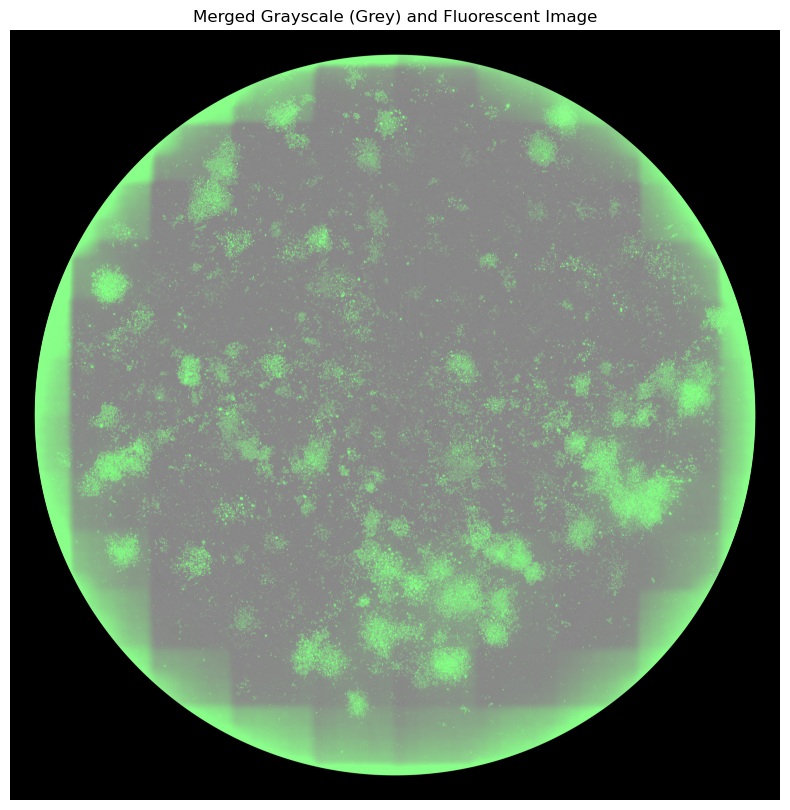

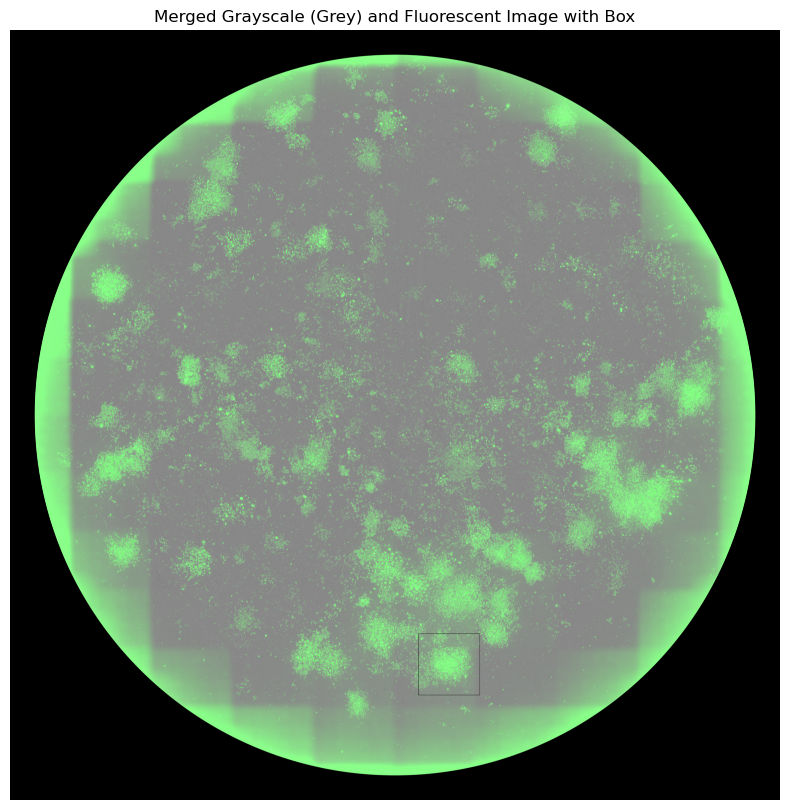

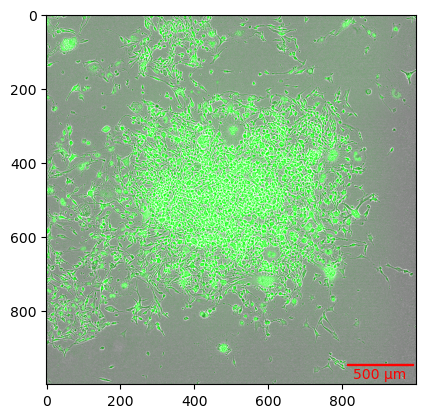

In [12]:
# Paths to the images
phase_image_path = Path(path_to_imgs + 'DLS083_Plate1_Phase_B3_1_30d00h00m.tif')
green_image_path = Path(path_to_imgs+'DLS083_Plate1_Green_B3_1_30d00h00m.tif')

# Read phase tiff using skimage
p1a1_phase = io.imread(phase_image_path)
h, w = p1a1_phase.shape
lum_im = Image.new('L', [w, h], 0)
draw = ImageDraw.Draw(lum_im)
draw.pieslice([(400, 400), (h - 400, w - 400)], 0, 360, fill=1)
lum_im_arr = np.asarray(lum_im)

# Rescale the intensity of the phase image
p1a1_phase_stretch = exposure.rescale_intensity(p1a1_phase, in_range=(120, 135), out_range='dtype').astype(np.float32)
# Cut the image and ensure background is zero
p1a1_phase_stretch_cut = p1a1_phase_stretch.copy()
p1a1_phase_stretch_cut[lum_im_arr == 0] = 0  # This line ensures background is zero

# Save the processed phase image
io.imsave('Plate1_WellB3_Phase.tif', p1a1_phase_stretch_cut.astype(np.float32))

# Read GFP tag tiff using skimage
p1a1_green = io.imread(green_image_path)
# Cut the image
p1a1_green_cut = p1a1_green.copy()
p1a1_green_cut[lum_im_arr == 0] = 0
# Rescale the intensity of the green image
p1a1_green_cut_stretch = exposure.rescale_intensity(p1a1_green_cut, in_range=(10, 120), out_range='dtype').astype(np.float32)

# Save the rescaled green image
io.imsave('Plate1_WellB3_Green.tif', p1a1_green_cut_stretch.astype(np.float32))

# Normalize images to range [0, 1]
p1a1_phase_stretch_cut_scale = exposure.rescale_intensity(p1a1_phase_stretch_cut, in_range='image', out_range=(0, 1))
p1a1_green_cut_stretch_scale = exposure.rescale_intensity(p1a1_green_cut_stretch, in_range='image', out_range=(0, 1))

# Create RGB version of grayscale image (grey)
grey_rgb_image = np.stack((p1a1_phase_stretch_cut_scale, p1a1_phase_stretch_cut_scale, p1a1_phase_stretch_cut_scale), axis=-1)

# Overlay the fluorescent image on top of the grey RGB image
# Assuming we want to overlay the fluorescent image in green channel
combined_image = grey_rgb_image.copy()
combined_image[..., 1] = np.maximum(grey_rgb_image[..., 1], p1a1_green_cut_stretch_scale)

# Display the result
plt.figure(figsize=(10, 10))
plt.imshow(combined_image)
plt.axis('off')
plt.title('Merged Grayscale (Grey) and Fluorescent Image')
plt.show()

# Save the combined image
tifffile.imwrite('Plate1_WellB3_merged.tif', (combined_image * 255).astype(np.uint8))

# Draw a box where the crop will be performed
rect_start = (7116 - 500, 10280 - 500)
rect_end = (7116 + 500, 10280 + 500)
rect_color = (1, 0, 0)  # Red color for the box

# Draw the rectangle on the combined image
combined_image_with_box = combined_image.copy()
combined_image_with_box = Image.fromarray((combined_image_with_box * 255).astype(np.uint8))
draw = ImageDraw.Draw(combined_image_with_box)
draw.rectangle([rect_start, rect_end], outline=rect_color, width=5)

# Display the result with the box
plt.figure(figsize=(10, 10))
plt.imshow(combined_image_with_box)
plt.axis('off')
plt.title('Merged Grayscale (Grey) and Fluorescent Image with Box')
plt.show()

# Save the combined image with the box
combined_image_with_box.save('Plate1_WellB3_merged_with_box.tif')

plt.imshow(combined_image, cmap = 'gray', vmin = 0, vmax = 1)
scalebar = AnchoredSizeBar(plt.gca().transData,
                           1798.561, '5 mm', 'lower right',
                           pad=0.1,
                           color='red',
                           frameon=False,
                           size_vertical=1)
plt.gca().add_artist(scalebar)
plt.savefig('Plate1_WellB3_merged_scale.tif')
plt.close()

# crop out a single clone
crop = combined_image[10280-500:10280+500,7116-500:7116+500]
tifffile.imwrite('Plate1_WellB3_merged_crop.tif', (crop * 255).astype(np.uint8))


plt.imshow(crop, cmap = 'gray', vmin = 0, vmax = 1)
scalebar = AnchoredSizeBar(plt.gca().transData,
                           179.8561, '500 µm', 'lower right',
                           pad=0.1,
                           color='red',
                           frameon=False,
                           size_vertical=1)
plt.gca().add_artist(scalebar)
plt.savefig('Plate1_WellB3_merged_crop_scale.tif')

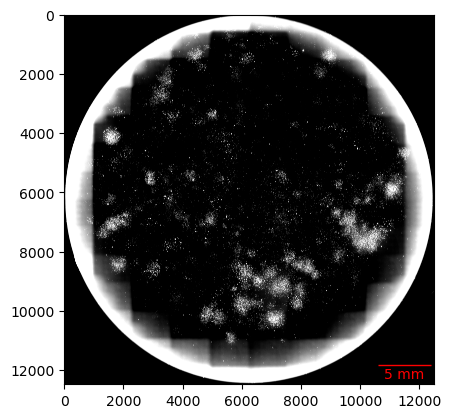

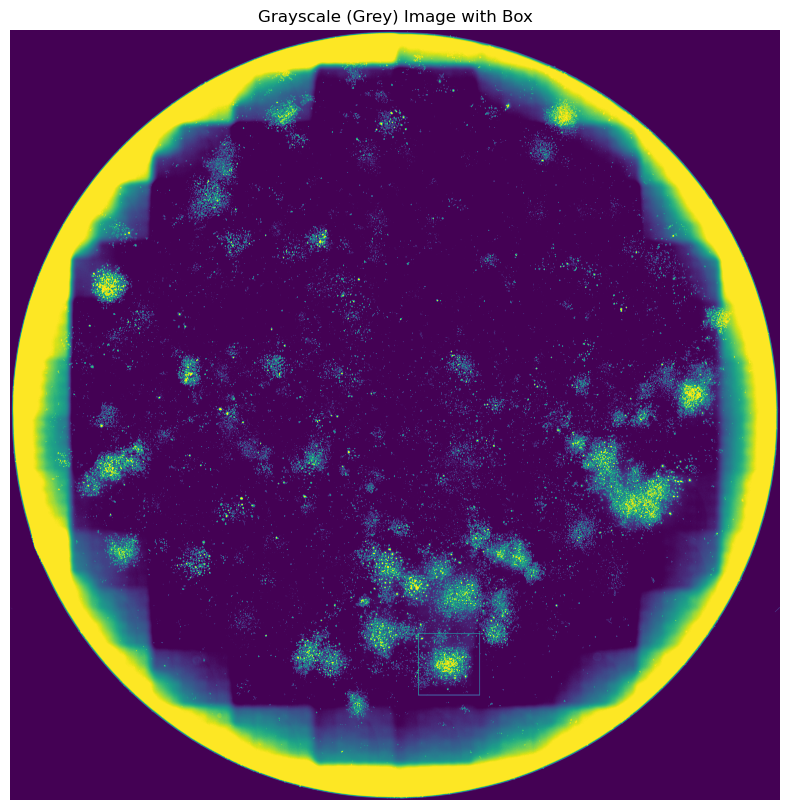

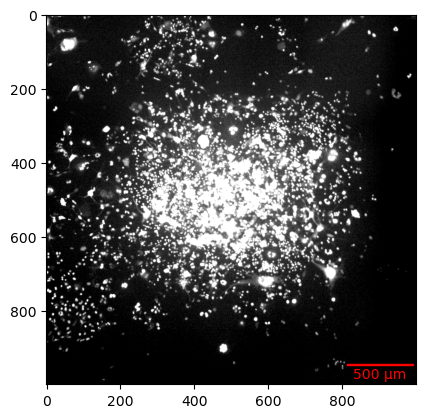

In [13]:
# Code for contrasting just the green image in greyscale
# read  tiff using skimage
green_image_path = Path(path_to_imgs+'DLS083_Plate1_Green_B3_1_30d00h00m.tif')
green_image = io.imread(green_image_path, as_gray=True).astype(np.float32)

# Rescale the intensity based on contrasting range
p1b3_green_stretch = exposure.rescale_intensity(green_image, in_range=(75,125), out_range='dtype').astype(np.float32)
plt.imshow(p1b3_green_stretch,cmap='gray', vmin=0, vmax=1)

scalebar = AnchoredSizeBar(plt.gca().transData,
                           1798.561, '5 mm', 'lower right',
                           pad=0.1,
                           color='red',
                           frameon=False,
                           size_vertical=1)
plt.gca().add_artist(scalebar)
plt.savefig('Plate1_B3_scalebar_Green_in_Grey.pdf')
plt.show()
# Save the full image 
io.imsave('Plate1_B3_Green_in_Grey.tif', p1b3_green_stretch)

# Draw a box where the crop will be performed
rect_start = (7116 - 500, 10280 - 500)
rect_end = (7116 + 500, 10280 + 500)
rect_color = (1, 0, 0)  # Red color for the box

# Draw the rectangle on the combined image
p1b3_green_stretch_with_box = p1b3_green_stretch.copy()
p1b3_green_stretch_with_box = Image.fromarray((p1b3_green_stretch_with_box * 255).astype(np.uint8))
draw = ImageDraw.Draw(p1b3_green_stretch_with_box)
draw.rectangle([rect_start, rect_end], outline='white', width=5)

# Display the result with the box
plt.figure(figsize=(10, 10))
plt.imshow(p1b3_green_stretch_with_box)
plt.axis('off')
plt.title('Grayscale (Grey) Image with Box')
plt.show()

# Save the combined image with the box
p1b3_green_stretch_with_box.save('Plate1_B3_Green_in_Grey_with_box.tif')

# crop out a single clone
crop = p1b3_green_stretch[10280-500:10280+500,7116-500:7116+500]
tifffile.imwrite('Plate1_B3_Green_in_Grey_crop.tif', (crop * 255).astype(np.uint8))


plt.imshow(crop, cmap = 'gray', vmin = 0, vmax = 1)
scalebar = AnchoredSizeBar(plt.gca().transData,
                           179.8561, '500 µm', 'lower right',
                           pad=0.1,
                           color='red',
                           frameon=False,
                           size_vertical=1)
plt.gca().add_artist(scalebar)
plt.savefig('Plate1_B3_Green_in_Grey_crop_scale.pdf')

Plate2 A1

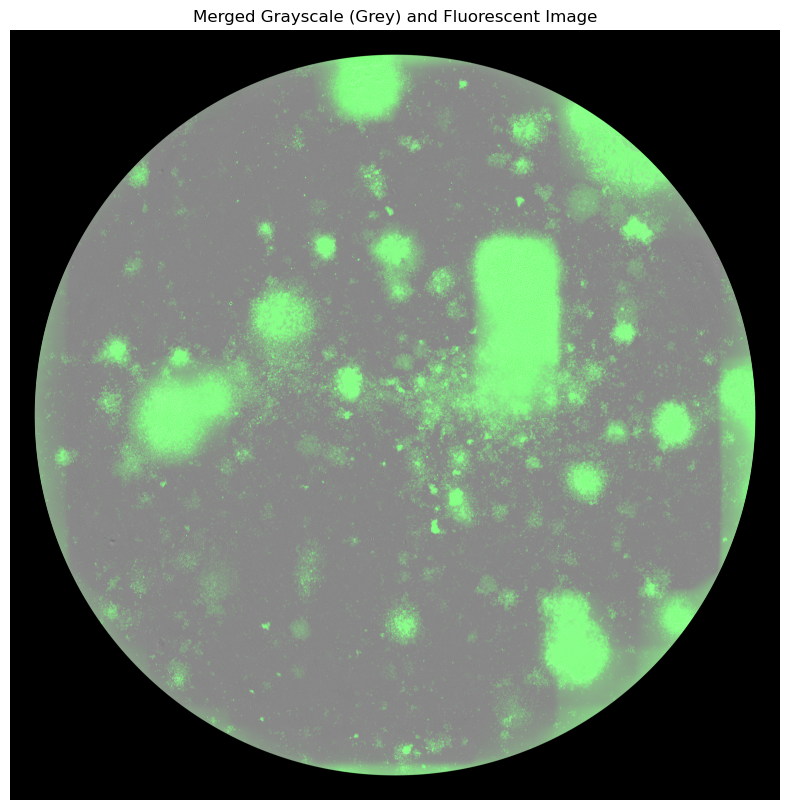

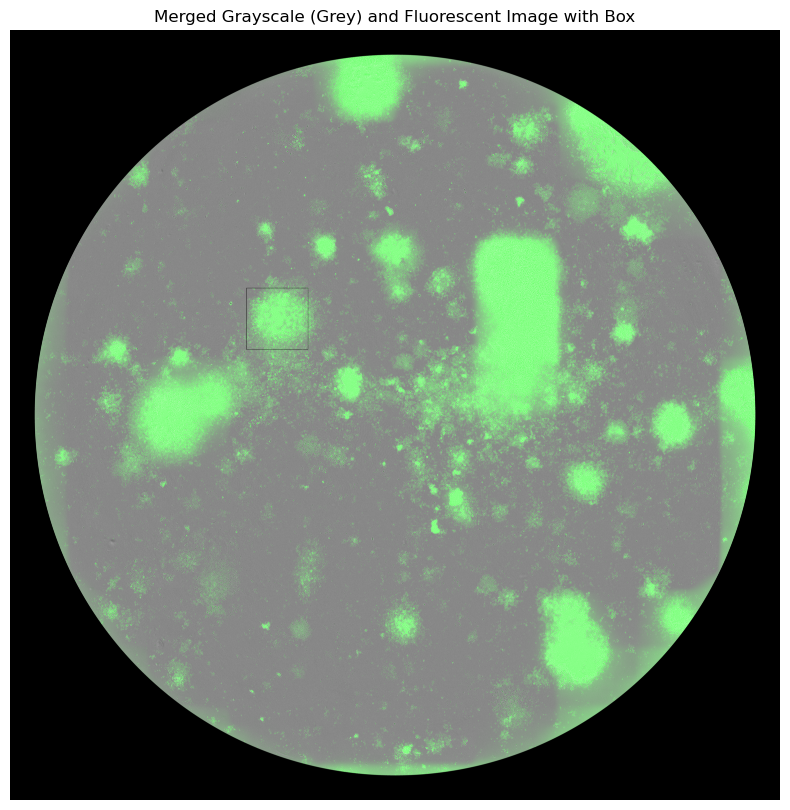

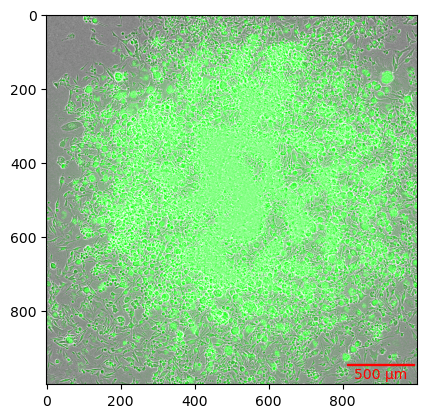

In [14]:
# Paths to the images
phase_image_path = Path(path_to_imgs + 'DLS083_Plate2_Phase_A1_1_30d00h50m.tif')
green_image_path = Path(path_to_imgs+'DLS083_Plate2_Green_A1_1_30d00h50m.tif')

# Read phase tiff using skimage
p1a1_phase = io.imread(phase_image_path)
h, w = p1a1_phase.shape
lum_im = Image.new('L', [w, h], 0)
draw = ImageDraw.Draw(lum_im)
draw.pieslice([(400, 400), (h - 400, w - 400)], 0, 360, fill=1)
lum_im_arr = np.asarray(lum_im)

# Rescale the intensity of the phase image
p1a1_phase_stretch = exposure.rescale_intensity(p1a1_phase, in_range=(120, 135), out_range='dtype').astype(np.float32)
# Cut the image and ensure background is zero
p1a1_phase_stretch_cut = p1a1_phase_stretch.copy()
p1a1_phase_stretch_cut[lum_im_arr == 0] = 0  # This line ensures background is zero

# Save the processed phase image
io.imsave('Plate2_WellA1_Phase.tif', p1a1_phase_stretch_cut.astype(np.float32))

# Read GFP tag tiff using skimage
p1a1_green = io.imread(green_image_path)
# Cut the image
p1a1_green_cut = p1a1_green.copy()
p1a1_green_cut[lum_im_arr == 0] = 0
# Rescale the intensity of the green image
p1a1_green_cut_stretch = exposure.rescale_intensity(p1a1_green_cut, in_range=(0, 200), out_range='dtype').astype(np.float32)

# Save the rescaled green image
io.imsave('Plate2_WellA1_Green.tif', p1a1_green_cut_stretch.astype(np.float32))

# Normalize images to range [0, 1]
p1a1_phase_stretch_cut_scale = exposure.rescale_intensity(p1a1_phase_stretch_cut, in_range='image', out_range=(0, 1))
p1a1_green_cut_stretch_scale = exposure.rescale_intensity(p1a1_green_cut_stretch, in_range='image', out_range=(0, 1))

# Create RGB version of grayscale image (grey)
grey_rgb_image = np.stack((p1a1_phase_stretch_cut_scale, p1a1_phase_stretch_cut_scale, p1a1_phase_stretch_cut_scale), axis=-1)

# Overlay the fluorescent image on top of the grey RGB image
# Assuming we want to overlay the fluorescent image in green channel
combined_image = grey_rgb_image.copy()
combined_image[..., 1] = np.maximum(grey_rgb_image[..., 1], p1a1_green_cut_stretch_scale)

# Display the result
plt.figure(figsize=(10, 10))
plt.imshow(combined_image)
plt.axis('off')
plt.title('Merged Grayscale (Grey) and Fluorescent Image')
plt.show()

# Save the combined image
tifffile.imwrite('Plate2_WellA1_merged.tif', (combined_image * 255).astype(np.uint8))

# Draw a box where the crop will be performed
rect_start = (4332 - 500, 4680 - 500)
rect_end = (4332 + 500, 4680 + 500)
rect_color = (1, 0, 0)  # Red color for the box

# Draw the rectangle on the combined image
combined_image_with_box = combined_image.copy()
combined_image_with_box = Image.fromarray((combined_image_with_box * 255).astype(np.uint8))
draw = ImageDraw.Draw(combined_image_with_box)
draw.rectangle([rect_start, rect_end], outline=rect_color, width=5)

# Display the result with the box
plt.figure(figsize=(10, 10))
plt.imshow(combined_image_with_box)
plt.axis('off')
plt.title('Merged Grayscale (Grey) and Fluorescent Image with Box')
plt.show()

# Save the combined image with the box
combined_image_with_box.save('Plate2_WellA1_merged_with_box.tif')

plt.imshow(combined_image, cmap = 'gray', vmin = 0, vmax = 1)
scalebar = AnchoredSizeBar(plt.gca().transData,
                           1798.561, '5 mm', 'lower right',
                           pad=0.1,
                           color='red',
                           frameon=False,
                           size_vertical=1)
plt.gca().add_artist(scalebar)
plt.savefig('Plate2_WellA1_merged_scale.tif')
plt.close()

# crop out a single clone
crop = combined_image[4682-500:4680+500,4332-500:4332+500]
tifffile.imwrite('Plate2_WellA1_merged_crop.tif', (crop * 255).astype(np.uint8))


plt.imshow(crop, cmap = 'gray', vmin = 0, vmax = 1)
scalebar = AnchoredSizeBar(plt.gca().transData,
                           179.8561, '500 µm', 'lower right',
                           pad=0.1,
                           color='red',
                           frameon=False,
                           size_vertical=1)
plt.gca().add_artist(scalebar)
plt.savefig('Plate2_WellA1_merged_crop_scale.tif')

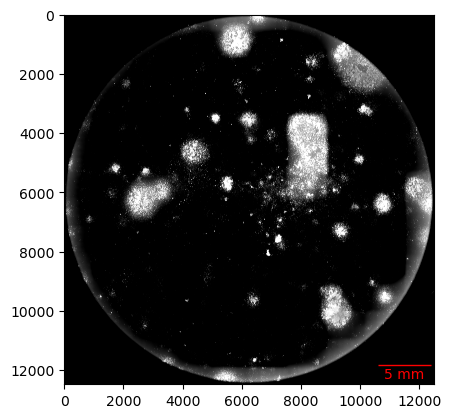

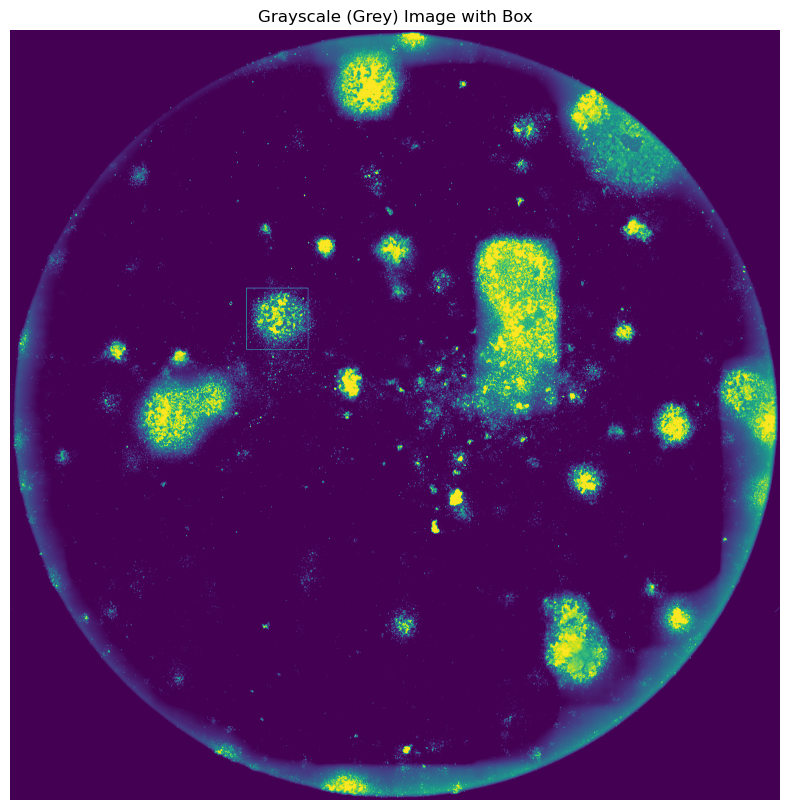

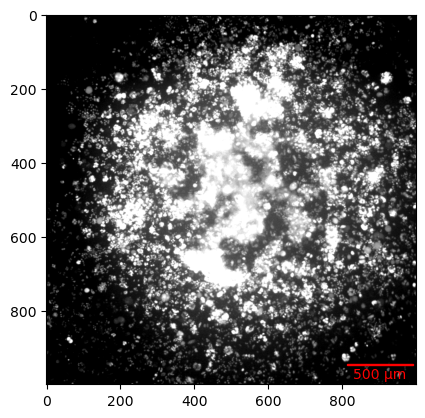

In [26]:
# Code for contrasting just the green image in greyscale
# read  tiff using skimage
green_image_path = Path(path_to_imgs+'DLS083_Plate2_Green_A1_1_30d00h50m.tif')
green_image = io.imread(green_image_path, as_gray=True).astype(np.float32)

# Rescale the intensity based on contrasting range
p2a1_green_stretch = exposure.rescale_intensity(green_image, in_range=(125,275), out_range='dtype').astype(np.float32)
plt.imshow(p2a1_green_stretch,cmap='gray', vmin=0, vmax=1)

scalebar = AnchoredSizeBar(plt.gca().transData,
                           1798.561, '5 mm', 'lower right',
                           pad=0.1,
                           color='red',
                           frameon=False,
                           size_vertical=1)
plt.gca().add_artist(scalebar)
plt.savefig('Plate2_A1_scalebar_Green_in_Grey.pdf')
plt.show()
# Save the full image 
io.imsave('Plate2_A1_Green_in_Grey.tif', p2a1_green_stretch)

# Draw a box where the crop will be performed
rect_start = (4332 - 500, 4680 - 500)
rect_end = (4332 + 500, 4680 + 500)
rect_color = (1, 0, 0)  # Red color for the box

# Draw the rectangle on the combined image
p2a1_green_stretch_with_box = p2a1_green_stretch.copy()
p2a1_green_stretch_with_box = Image.fromarray((p2a1_green_stretch_with_box * 255).astype(np.uint8))
draw = ImageDraw.Draw(p2a1_green_stretch_with_box)
draw.rectangle([rect_start, rect_end], outline='white', width=5)

# Display the result with the box
plt.figure(figsize=(10, 10))
plt.imshow(p2a1_green_stretch_with_box)
plt.axis('off')
plt.title('Grayscale (Grey) Image with Box')
plt.show()

# Save the combined image with the box
p2a1_green_stretch_with_box.save('Plate2_A1_Green_in_Grey_with_box.tif')

# crop out a single clone
crop = p2a1_green_stretch[4680-500:4680+500,4332-500:4332+500]
tifffile.imwrite('Plate2_A1_Green_in_Grey_crop.tif', (crop * 255).astype(np.uint8))


plt.imshow(crop, cmap = 'gray', vmin = 0, vmax = 1)
scalebar = AnchoredSizeBar(plt.gca().transData,
                           179.8561, '500 µm', 'lower right',
                           pad=0.1,
                           color='red',
                           frameon=False,
                           size_vertical=1)
plt.gca().add_artist(scalebar)
plt.savefig('Plate2_A1_Green_in_Grey_crop_scale.pdf')

Plate2 A2


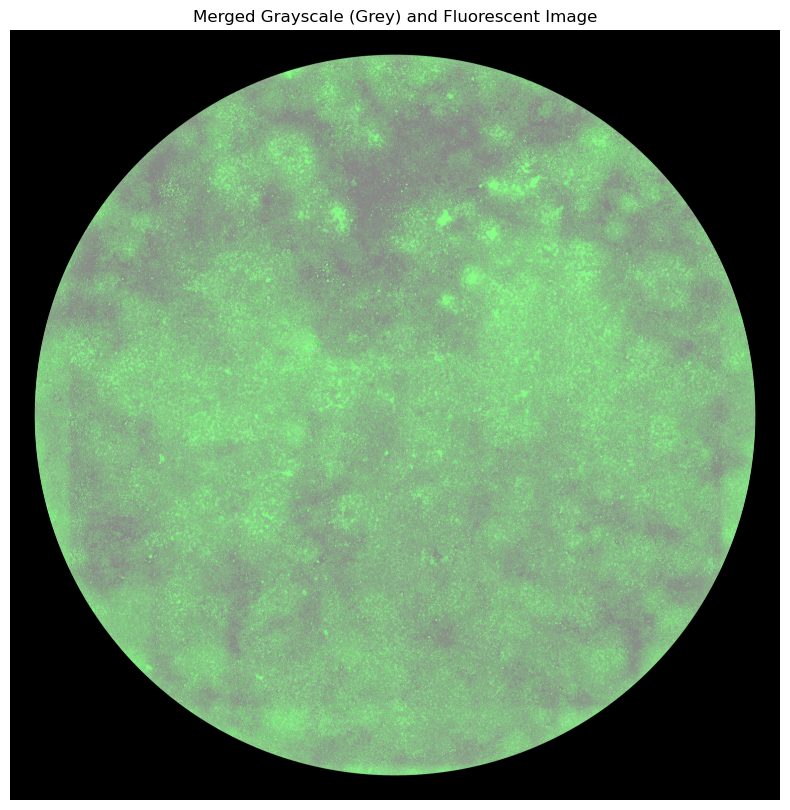

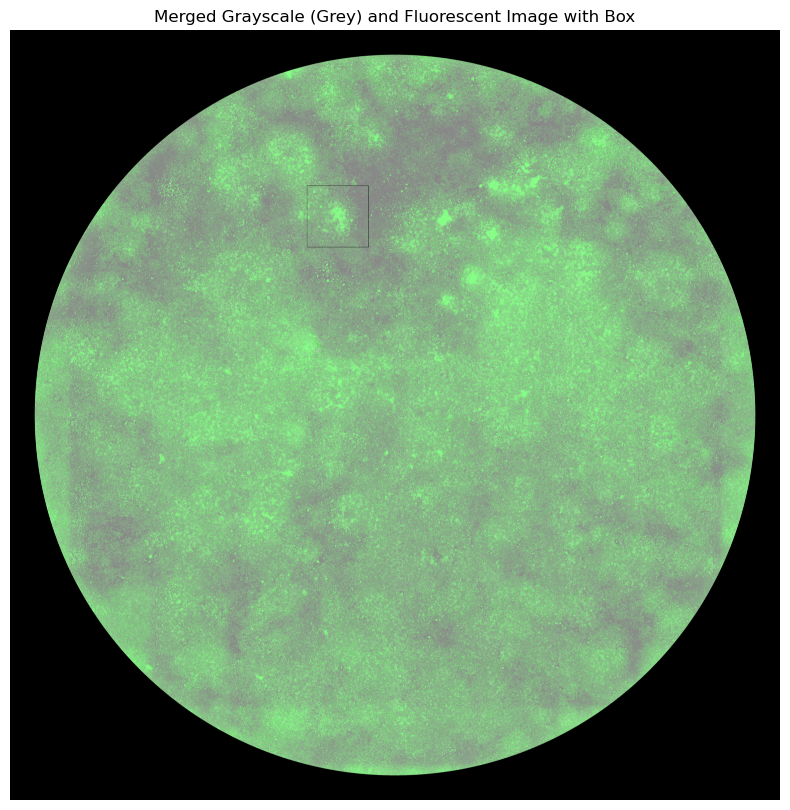

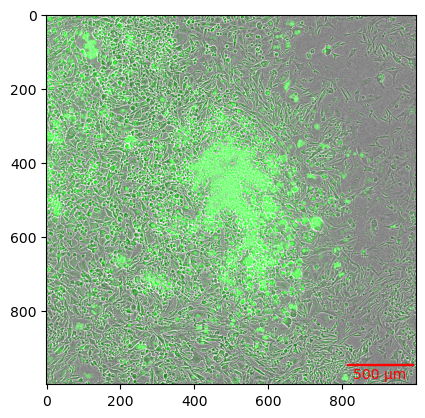

In [16]:
# Paths to the images
phase_image_path = Path(path_to_imgs + 'DLS083_Plate2_Phase_A2_1_30d00h50m.tif')
green_image_path = Path(path_to_imgs+'DLS083_Plate2_Green_A2_1_30d00h50m.tif')

# Read phase tiff using skimage
p1a1_phase = io.imread(phase_image_path)
h, w = p1a1_phase.shape
lum_im = Image.new('L', [w, h], 0)
draw = ImageDraw.Draw(lum_im)
draw.pieslice([(400, 400), (h - 400, w - 400)], 0, 360, fill=1)
lum_im_arr = np.asarray(lum_im)

# Rescale the intensity of the phase image
p1a1_phase_stretch = exposure.rescale_intensity(p1a1_phase, in_range=(120, 135), out_range='dtype').astype(np.float32)
# Cut the image and ensure background is zero
p1a1_phase_stretch_cut = p1a1_phase_stretch.copy()
p1a1_phase_stretch_cut[lum_im_arr == 0] = 0  # This line ensures background is zero

# Save the processed phase image
io.imsave('Plate2_WellA2_Phase.tif', p1a1_phase_stretch_cut.astype(np.float32))

# Read GFP tag tiff using skimage
p1a1_green = io.imread(green_image_path)
# Cut the image
p1a1_green_cut = p1a1_green.copy()
p1a1_green_cut[lum_im_arr == 0] = 0
# Rescale the intensity of the green image
p1a1_green_cut_stretch = exposure.rescale_intensity(p1a1_green_cut, in_range=(0, 300), out_range='dtype').astype(np.float32)

# Save the rescaled green image
io.imsave('Plate2_WellA2_Green.tif', p1a1_green_cut_stretch.astype(np.float32))

# Normalize images to range [0, 1]
p1a1_phase_stretch_cut_scale = exposure.rescale_intensity(p1a1_phase_stretch_cut, in_range='image', out_range=(0, 1))
p1a1_green_cut_stretch_scale = exposure.rescale_intensity(p1a1_green_cut_stretch, in_range='image', out_range=(0, 1))

# Create RGB version of grayscale image (grey)
grey_rgb_image = np.stack((p1a1_phase_stretch_cut_scale, p1a1_phase_stretch_cut_scale, p1a1_phase_stretch_cut_scale), axis=-1)

# Overlay the fluorescent image on top of the grey RGB image
# Assuming we want to overlay the fluorescent image in green channel
combined_image = grey_rgb_image.copy()
combined_image[..., 1] = np.maximum(grey_rgb_image[..., 1], p1a1_green_cut_stretch_scale)

# Display the result
plt.figure(figsize=(10, 10))
plt.imshow(combined_image)
plt.axis('off')
plt.title('Merged Grayscale (Grey) and Fluorescent Image')
plt.show()

# Save the combined image
tifffile.imwrite('Plate2_WellA2_merged.tif', (combined_image * 255).astype(np.uint8))

# Draw a box where the crop will be performed
rect_start = (5312 - 500, 3020 - 500)
rect_end = (5312 + 500, 3020 + 500)
rect_color = (1, 0, 0)  # Red color for the box

# Draw the rectangle on the combined image
combined_image_with_box = combined_image.copy()
combined_image_with_box = Image.fromarray((combined_image_with_box * 255).astype(np.uint8))
draw = ImageDraw.Draw(combined_image_with_box)
draw.rectangle([rect_start, rect_end], outline=rect_color, width=5)

# Display the result with the box
plt.figure(figsize=(10, 10))
plt.imshow(combined_image_with_box)
plt.axis('off')
plt.title('Merged Grayscale (Grey) and Fluorescent Image with Box')
plt.show()

# Save the combined image with the box
combined_image_with_box.save('Plate2_WellA2_merged_with_box.tif')

plt.imshow(combined_image, cmap = 'gray', vmin = 0, vmax = 1)
scalebar = AnchoredSizeBar(plt.gca().transData,
                           1798.561, '5 mm', 'lower right',
                           pad=0.1,
                           color='red',
                           frameon=False,
                           size_vertical=1)
plt.gca().add_artist(scalebar)
plt.savefig('Plate2_WellA2_merged_scale.tif')
plt.close()

# crop out a single clone
crop = combined_image[3020-500:3020+500,5312-500:5312+500]
tifffile.imwrite('Plate2_WellA2_merged_crop.tif', (crop * 255).astype(np.uint8))


plt.imshow(crop, cmap = 'gray', vmin = 0, vmax = 1)
scalebar = AnchoredSizeBar(plt.gca().transData,
                           179.8561, '500 µm', 'lower right',
                           pad=0.1,
                           color='red',
                           frameon=False,
                           size_vertical=1)
plt.gca().add_artist(scalebar)
plt.savefig('Plate2_WellA2_merged_crop_scale.tif')

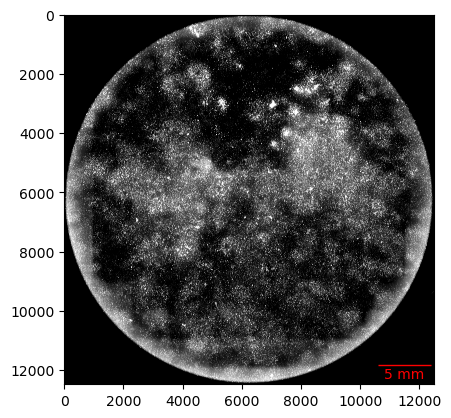

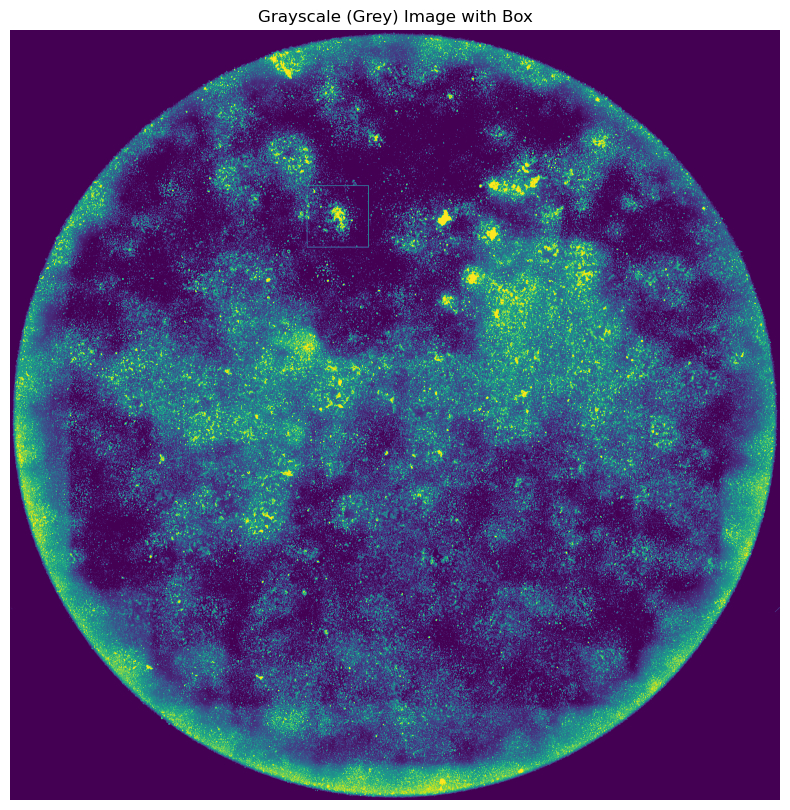

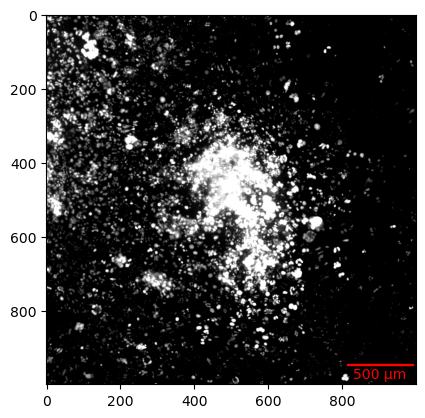

In [17]:
# Code for contrasting just the green image in greyscale
# read  tiff using skimage
green_image_path = Path(path_to_imgs+'DLS083_Plate2_Green_A2_1_30d00h50m.tif')
green_image = io.imread(green_image_path, as_gray=True).astype(np.float32)

# Rescale the intensity based on contrasting range
p2a2_green_stretch = exposure.rescale_intensity(green_image, in_range=(175,300), out_range='dtype').astype(np.float32)
plt.imshow(p2a2_green_stretch,cmap='gray', vmin=0, vmax=1)

scalebar = AnchoredSizeBar(plt.gca().transData,
                           1798.561, '5 mm', 'lower right',
                           pad=0.1,
                           color='red',
                           frameon=False,
                           size_vertical=1)
plt.gca().add_artist(scalebar)
plt.savefig('Plate2_A2_scalebar_Green_in_Grey.pdf')
plt.show()
# Save the full image 
io.imsave('Plate2_A2_Green_in_Grey.tif', p2a2_green_stretch)

# Draw a box where the crop will be performed
rect_start = (5312 - 500, 3020 - 500)
rect_end = (5312 + 500, 3020 + 500)
rect_color = (1, 0, 0)  # Red color for the box

# Draw the rectangle on the combined image
p2a2_green_stretch_with_box = p2a2_green_stretch.copy()
p2a2_green_stretch_with_box = Image.fromarray((p2a2_green_stretch_with_box * 255).astype(np.uint8))
draw = ImageDraw.Draw(p2a2_green_stretch_with_box)
draw.rectangle([rect_start, rect_end], outline='white', width=5)

# Display the result with the box
plt.figure(figsize=(10, 10))
plt.imshow(p2a2_green_stretch_with_box)
plt.axis('off')
plt.title('Grayscale (Grey) Image with Box')
plt.show()

# Save the combined image with the box
p2a2_green_stretch_with_box.save('Plate2_A2_Green_in_Grey_with_box.tif')

# crop out a single clone
crop = p2a2_green_stretch[3020-500:3020+500,5312-500:5312+500]
tifffile.imwrite('Plate2_A2_Green_in_Grey_crop.tif', (crop * 255).astype(np.uint8))


plt.imshow(crop, cmap = 'gray', vmin = 0, vmax = 1)
scalebar = AnchoredSizeBar(plt.gca().transData,
                           179.8561, '500 µm', 'lower right',
                           pad=0.1,
                           color='red',
                           frameon=False,
                           size_vertical=1)
plt.gca().add_artist(scalebar)
plt.savefig('Plate2_A2_Green_in_Grey_crop_scale.pdf')

Plate2 A3

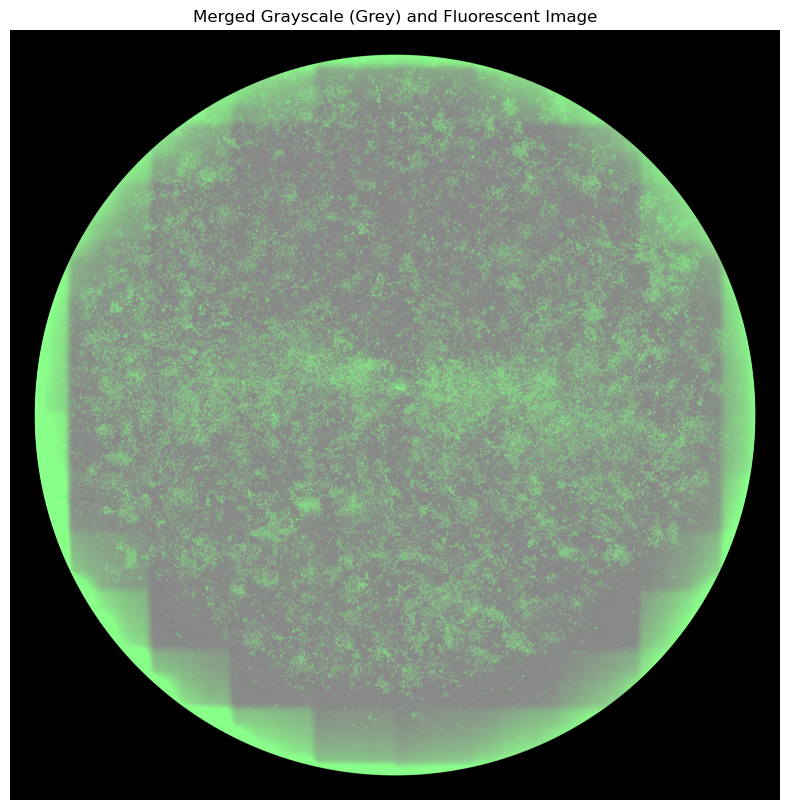

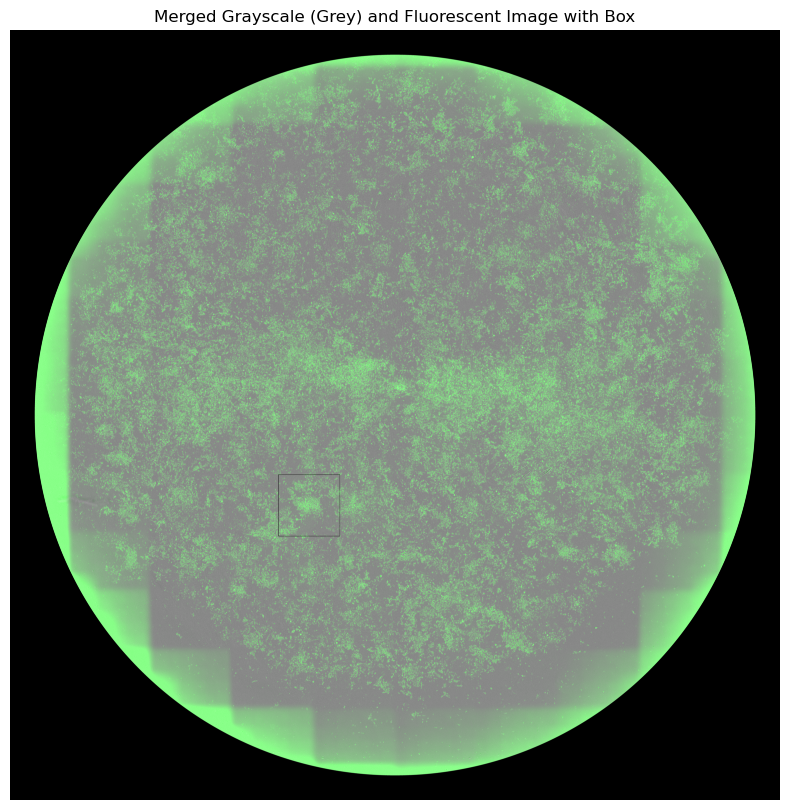

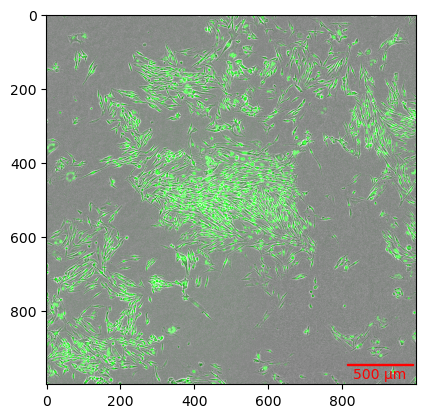

In [18]:
# Paths to the images
phase_image_path = Path(path_to_imgs + 'DLS083_Plate2_Phase_A3_1_30d00h50m.tif')
green_image_path = Path(path_to_imgs+'DLS083_Plate2_Green_A3_1_30d00h50m.tif')

# Read phase tiff using skimage
p1a1_phase = io.imread(phase_image_path)
h, w = p1a1_phase.shape
lum_im = Image.new('L', [w, h], 0)
draw = ImageDraw.Draw(lum_im)
draw.pieslice([(400, 400), (h - 400, w - 400)], 0, 360, fill=1)
lum_im_arr = np.asarray(lum_im)

# Rescale the intensity of the phase image
p1a1_phase_stretch = exposure.rescale_intensity(p1a1_phase, in_range=(120, 135), out_range='dtype').astype(np.float32)
# Cut the image and ensure background is zero
p1a1_phase_stretch_cut = p1a1_phase_stretch.copy()
p1a1_phase_stretch_cut[lum_im_arr == 0] = 0  # This line ensures background is zero

# Save the processed phase image
io.imsave('Plate2_WellA3_Phase.tif', p1a1_phase_stretch_cut.astype(np.float32))

# Read GFP tag tiff using skimage
p1a1_green = io.imread(green_image_path)
# Cut the image
p1a1_green_cut = p1a1_green.copy()
p1a1_green_cut[lum_im_arr == 0] = 0
# Rescale the intensity of the green image
p1a1_green_cut_stretch = exposure.rescale_intensity(p1a1_green_cut, in_range=(0, 120), out_range='dtype').astype(np.float32)

# Save the rescaled green image
io.imsave('Plate2_WellA3_Green.tif', p1a1_green_cut_stretch.astype(np.float32))

# Normalize images to range [0, 1]
p1a1_phase_stretch_cut_scale = exposure.rescale_intensity(p1a1_phase_stretch_cut, in_range='image', out_range=(0, 1))
p1a1_green_cut_stretch_scale = exposure.rescale_intensity(p1a1_green_cut_stretch, in_range='image', out_range=(0, 1))

# Create RGB version of grayscale image (grey)
grey_rgb_image = np.stack((p1a1_phase_stretch_cut_scale, p1a1_phase_stretch_cut_scale, p1a1_phase_stretch_cut_scale), axis=-1)

# Overlay the fluorescent image on top of the grey RGB image
# Assuming we want to overlay the fluorescent image in green channel
combined_image = grey_rgb_image.copy()
combined_image[..., 1] = np.maximum(grey_rgb_image[..., 1], p1a1_green_cut_stretch_scale)

# Display the result
plt.figure(figsize=(10, 10))
plt.imshow(combined_image)
plt.axis('off')
plt.title('Merged Grayscale (Grey) and Fluorescent Image')
plt.show()

# Save the combined image
tifffile.imwrite('Plate2_WellA3_merged.tif', (combined_image * 255).astype(np.uint8))

# Draw a box where the crop will be performed
rect_start = (4848 - 500, 7704 - 500)
rect_end = (4848 + 500, 7704 + 500)
rect_color = (1, 0, 0)  # Red color for the box

# Draw the rectangle on the combined image
combined_image_with_box = combined_image.copy()
combined_image_with_box = Image.fromarray((combined_image_with_box * 255).astype(np.uint8))
draw = ImageDraw.Draw(combined_image_with_box)
draw.rectangle([rect_start, rect_end], outline=rect_color, width=5)

# Display the result with the box
plt.figure(figsize=(10, 10))
plt.imshow(combined_image_with_box)
plt.axis('off')
plt.title('Merged Grayscale (Grey) and Fluorescent Image with Box')
plt.show()

# Save the combined image with the box
combined_image_with_box.save('Plate2_WellA3_merged_with_box.tif')

plt.imshow(combined_image, cmap = 'gray', vmin = 0, vmax = 1)
scalebar = AnchoredSizeBar(plt.gca().transData,
                           1798.561, '5 mm', 'lower right',
                           pad=0.1,
                           color='red',
                           frameon=False,
                           size_vertical=1)
plt.gca().add_artist(scalebar)
plt.savefig('Plate2_WellA3_merged_scale.tif')
plt.close()

# crop out a single clone
crop = combined_image[7704-500:7704+500,4848-500:4848+500]
tifffile.imwrite('Plate2_WellA3_merged_crop.tif', (crop * 255).astype(np.uint8))


plt.imshow(crop, cmap = 'gray', vmin = 0, vmax = 1)
scalebar = AnchoredSizeBar(plt.gca().transData,
                           179.8561, '500 µm', 'lower right',
                           pad=0.1,
                           color='red',
                           frameon=False,
                           size_vertical=1)
plt.gca().add_artist(scalebar)
plt.savefig('Plate2_WellA3_merged_crop_scale.tif')

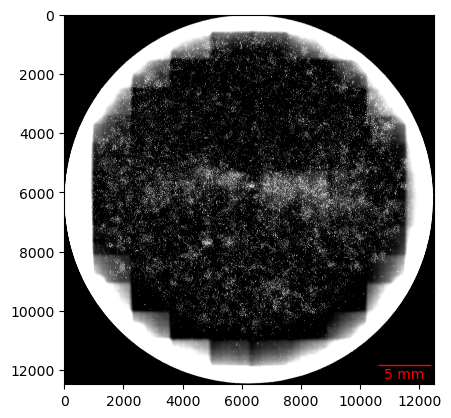

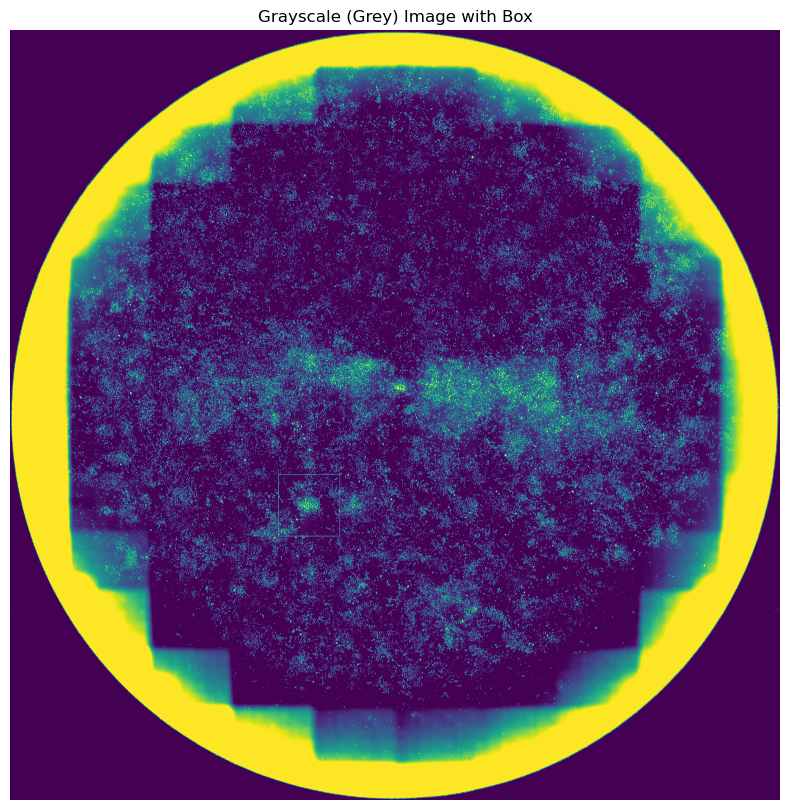

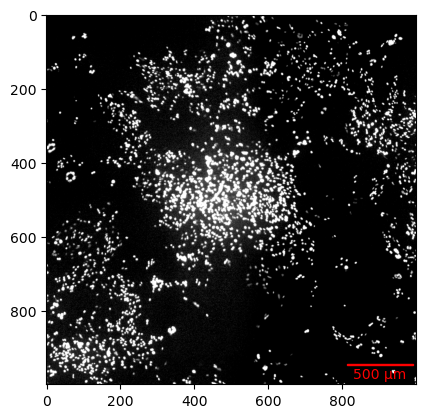

In [32]:
# Code for contrasting just the green image in greyscale
# read  tiff using skimage
green_image_path = Path(path_to_imgs+'DLS083_Plate2_Green_A3_1_30d00h50m.tif')
green_image = io.imread(green_image_path, as_gray=True).astype(np.float32)

# Rescale the intensity based on contrasting range
p2a3_green_stretch = exposure.rescale_intensity(green_image, in_range=(65,100), out_range='dtype').astype(np.float32)
plt.imshow(p2a3_green_stretch,cmap='gray', vmin=0, vmax=1)

scalebar = AnchoredSizeBar(plt.gca().transData,
                           1798.561, '5 mm', 'lower right',
                           pad=0.1,
                           color='red',
                           frameon=False,
                           size_vertical=1)
plt.gca().add_artist(scalebar)
plt.savefig('Plate2_A3_scalebar_Green_in_Grey.pdf')
plt.show()
# Save the full image 
io.imsave('Plate2_A3_Green_in_Grey.tif', p2a3_green_stretch)

# Draw a box where the crop will be performed
rect_start = (4848 - 500, 7704 - 500)
rect_end = (4848 + 500, 7704 + 500)
rect_color = (1, 0, 0)  # Red color for the box

# Draw the rectangle on the combined image
p2a3_green_stretch_with_box = p2a3_green_stretch.copy()
p2a3_green_stretch_with_box = Image.fromarray((p2a3_green_stretch_with_box * 255).astype(np.uint8))
draw = ImageDraw.Draw(p2a3_green_stretch_with_box)
draw.rectangle([rect_start, rect_end], outline='white', width=5)

# Display the result with the box
plt.figure(figsize=(10, 10))
plt.imshow(p2a3_green_stretch_with_box)
plt.axis('off')
plt.title('Grayscale (Grey) Image with Box')
plt.show()

# Save the combined image with the box
p2a3_green_stretch_with_box.save('Plate2_A3_Green_in_Grey_with_box.tif')

# crop out a single clone
crop = p2a3_green_stretch[7704-500:7704+500,4848-500:4848+500]
tifffile.imwrite('Plate2_A3_Green_in_Grey_crop.tif', (crop * 255).astype(np.uint8))


plt.imshow(crop, cmap = 'gray', vmin = 0, vmax = 1)
scalebar = AnchoredSizeBar(plt.gca().transData,
                           179.8561, '500 µm', 'lower right',
                           pad=0.1,
                           color='red',
                           frameon=False,
                           size_vertical=1)
plt.gca().add_artist(scalebar)
plt.savefig('Plate2_A3_Green_in_Grey_crop_scale.pdf')

Plate2 B1

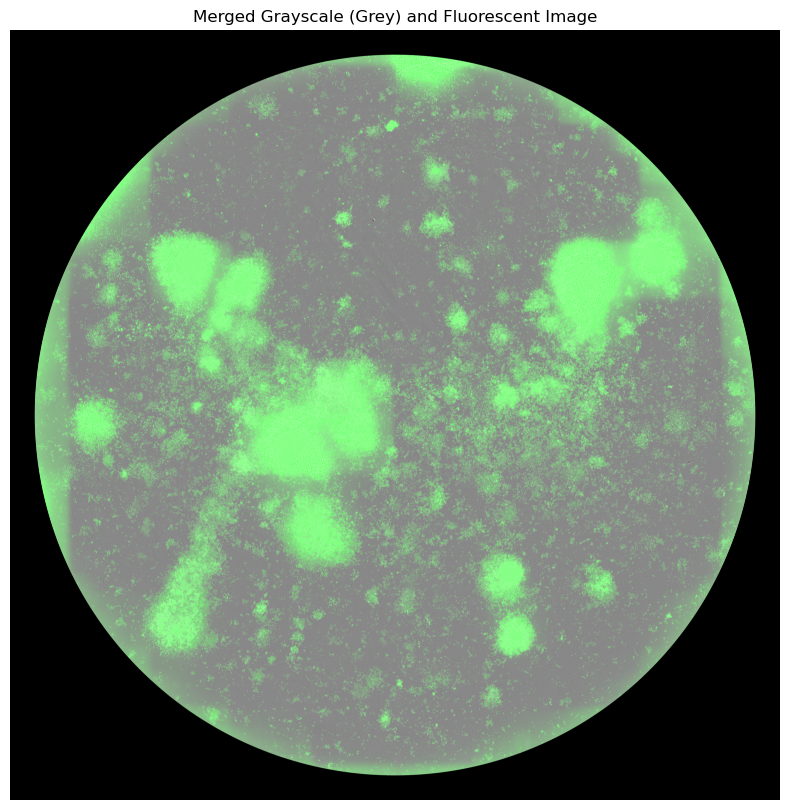

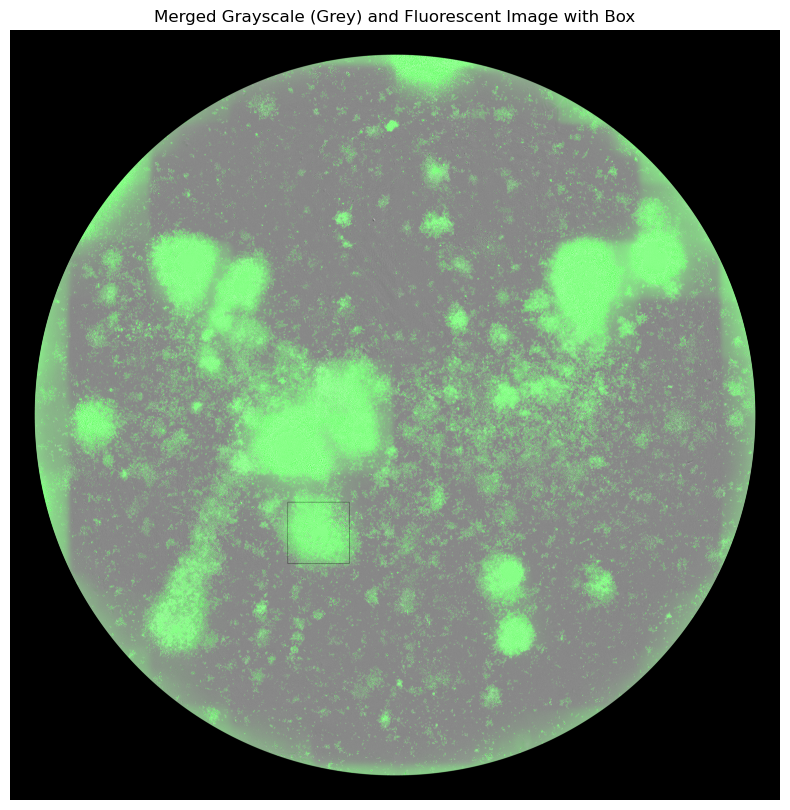

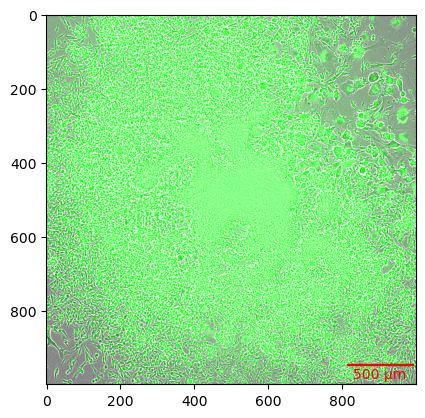

In [20]:
# Paths to the images
phase_image_path = Path(path_to_imgs + 'DLS083_Plate2_Phase_B1_1_30d00h50m.tif')
green_image_path = Path(path_to_imgs+'DLS083_Plate2_Green_B1_1_30d00h50m.tif')

# Read phase tiff using skimage
p1a1_phase = io.imread(phase_image_path)
h, w = p1a1_phase.shape
lum_im = Image.new('L', [w, h], 0)
draw = ImageDraw.Draw(lum_im)
draw.pieslice([(400, 400), (h - 400, w - 400)], 0, 360, fill=1)
lum_im_arr = np.asarray(lum_im)

# Rescale the intensity of the phase image
p1a1_phase_stretch = exposure.rescale_intensity(p1a1_phase, in_range=(120, 135), out_range='dtype').astype(np.float32)
# Cut the image and ensure background is zero
p1a1_phase_stretch_cut = p1a1_phase_stretch.copy()
p1a1_phase_stretch_cut[lum_im_arr == 0] = 0  # This line ensures background is zero

# Save the processed phase image
io.imsave('Plate2_WellB1_Phase.tif', p1a1_phase_stretch_cut.astype(np.float32))

# Read GFP tag tiff using skimage
p1a1_green = io.imread(green_image_path)
# Cut the image
p1a1_green_cut = p1a1_green.copy()
p1a1_green_cut[lum_im_arr == 0] = 0
# Rescale the intensity of the green image
p1a1_green_cut_stretch = exposure.rescale_intensity(p1a1_green_cut, in_range=(0, 160), out_range='dtype').astype(np.float32)

# Save the rescaled green image
io.imsave('Plate2_WellB1_Green.tif', p1a1_green_cut_stretch.astype(np.float32))

# Normalize images to range [0, 1]
p1a1_phase_stretch_cut_scale = exposure.rescale_intensity(p1a1_phase_stretch_cut, in_range='image', out_range=(0, 1))
p1a1_green_cut_stretch_scale = exposure.rescale_intensity(p1a1_green_cut_stretch, in_range='image', out_range=(0, 1))

# Create RGB version of grayscale image (grey)
grey_rgb_image = np.stack((p1a1_phase_stretch_cut_scale, p1a1_phase_stretch_cut_scale, p1a1_phase_stretch_cut_scale), axis=-1)

# Overlay the fluorescent image on top of the grey RGB image
# Assuming we want to overlay the fluorescent image in green channel
combined_image = grey_rgb_image.copy()
combined_image[..., 1] = np.maximum(grey_rgb_image[..., 1], p1a1_green_cut_stretch_scale)

# Display the result
plt.figure(figsize=(10, 10))
plt.imshow(combined_image)
plt.axis('off')
plt.title('Merged Grayscale (Grey) and Fluorescent Image')
plt.show()

# Save the combined image
tifffile.imwrite('Plate2_WellB1_merged.tif', (combined_image * 255).astype(np.uint8))

# Draw a box where the crop will be performed
rect_start = (5000 - 500, 8150 - 500)
rect_end = (5000 + 500, 8150 + 500)
rect_color = (1, 0, 0)  # Red color for the box

# Draw the rectangle on the combined image
combined_image_with_box = combined_image.copy()
combined_image_with_box = Image.fromarray((combined_image_with_box * 255).astype(np.uint8))
draw = ImageDraw.Draw(combined_image_with_box)
draw.rectangle([rect_start, rect_end], outline=rect_color, width=5)

# Display the result with the box
plt.figure(figsize=(10, 10))
plt.imshow(combined_image_with_box)
plt.axis('off')
plt.title('Merged Grayscale (Grey) and Fluorescent Image with Box')
plt.show()

# Save the combined image with the box
combined_image_with_box.save('Plate2_WellB1_merged_with_box.tif')

plt.imshow(combined_image, cmap = 'gray', vmin = 0, vmax = 1)
scalebar = AnchoredSizeBar(plt.gca().transData,
                           1798.561, '5 mm', 'lower right',
                           pad=0.1,
                           color='red',
                           frameon=False,
                           size_vertical=1)
plt.gca().add_artist(scalebar)
plt.savefig('Plate2_WellB1_merged_scale.tif')
plt.close()

# crop out a single clone
crop = combined_image[8150-500:8150+500,5000-500:5000+500]
tifffile.imwrite('Plate2_WellB1_merged_crop.tif', (crop * 255).astype(np.uint8))


plt.imshow(crop, cmap = 'gray', vmin = 0, vmax = 1)
scalebar = AnchoredSizeBar(plt.gca().transData,
                           179.8561, '500 µm', 'lower right',
                           pad=0.1,
                           color='red',
                           frameon=False,
                           size_vertical=1)
plt.gca().add_artist(scalebar)
plt.savefig('Plate2_WellB1_merged_crop_scale.tif')

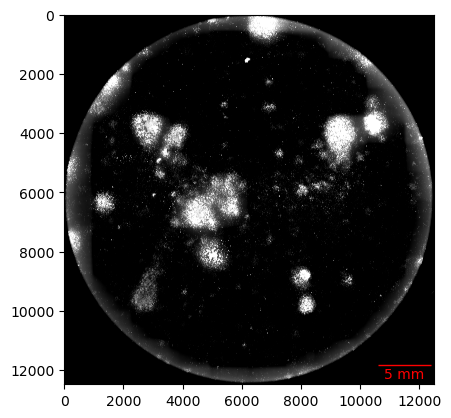

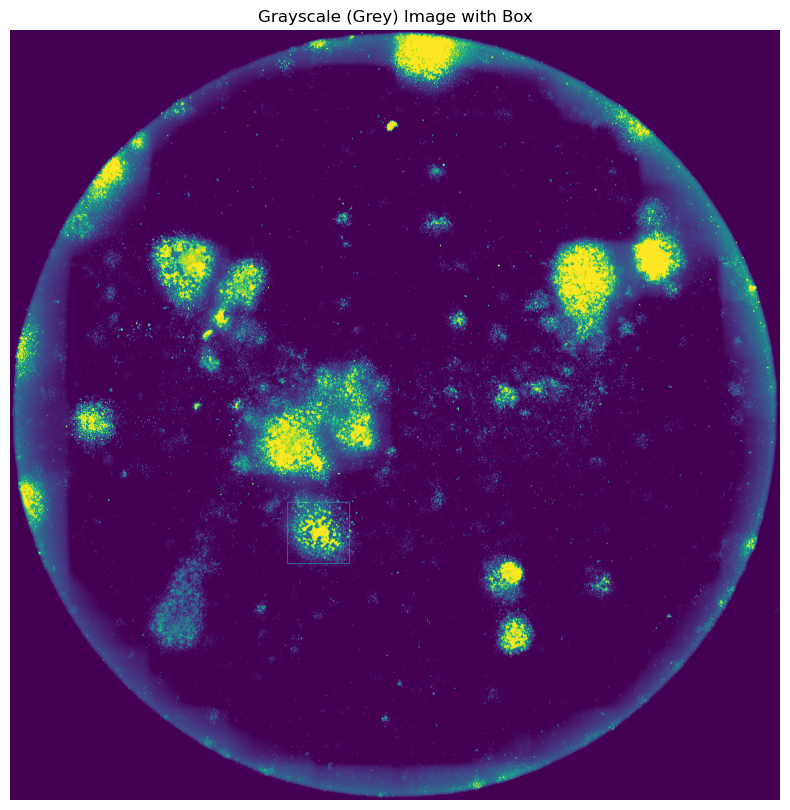

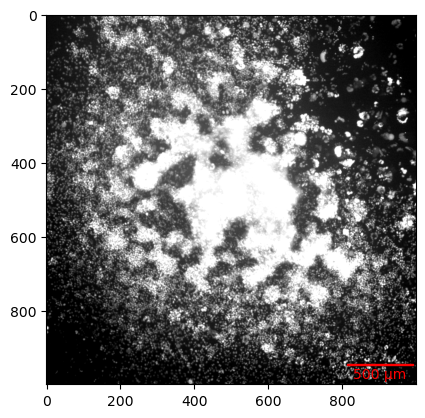

In [21]:
# Code for contrasting just the green image in greyscale
# read  tiff using skimage
green_image_path = Path(path_to_imgs+'DLS083_Plate2_Green_B1_1_30d00h50m.tif')
green_image = io.imread(green_image_path, as_gray=True).astype(np.float32)

# Rescale the intensity based on contrasting range
p2b1_green_stretch = exposure.rescale_intensity(green_image, in_range=(100 ,275), out_range='dtype').astype(np.float32)
plt.imshow(p2b1_green_stretch,cmap='gray', vmin=0, vmax=1)

scalebar = AnchoredSizeBar(plt.gca().transData,
                           1798.561, '5 mm', 'lower right',
                           pad=0.1,
                           color='red',
                           frameon=False,
                           size_vertical=1)
plt.gca().add_artist(scalebar)
plt.savefig('Plate2_B1_scalebar_Green_in_Grey.pdf')
plt.show()
# Save the full image 
io.imsave('Plate2_B1_Green_in_Grey.tif', p2b1_green_stretch)

# Draw a box where the crop will be performed
rect_start = (5000 - 500, 8150 - 500)
rect_end = (5000 + 500, 8150 + 500)
rect_color = (1, 0, 0)  # Red color for the box

# Draw the rectangle on the combined image
p2b1_green_stretch_with_box = p2b1_green_stretch.copy()
p2b1_green_stretch_with_box = Image.fromarray((p2b1_green_stretch_with_box * 255).astype(np.uint8))
draw = ImageDraw.Draw(p2b1_green_stretch_with_box)
draw.rectangle([rect_start, rect_end], outline='white', width=5)

# Display the result with the box
plt.figure(figsize=(10, 10))
plt.imshow(p2b1_green_stretch_with_box)
plt.axis('off')
plt.title('Grayscale (Grey) Image with Box')
plt.show()

# Save the combined image with the box
p2b1_green_stretch_with_box.save('Plate2_B1_Green_in_Grey_with_box.tif')

# crop out a single clone
crop = p2b1_green_stretch[8150-500:8150+500,5000-500:5000+500]
tifffile.imwrite('Plate2_B1_Green_in_Grey_crop.tif', (crop * 255).astype(np.uint8))


plt.imshow(crop, cmap = 'gray', vmin = 0, vmax = 1)
scalebar = AnchoredSizeBar(plt.gca().transData,
                           179.8561, '500 µm', 'lower right',
                           pad=0.1,
                           color='red',
                           frameon=False,
                           size_vertical=1)
plt.gca().add_artist(scalebar)
plt.savefig('Plate2_B1_Green_in_Grey_crop_scale.pdf')

Plate2 B2

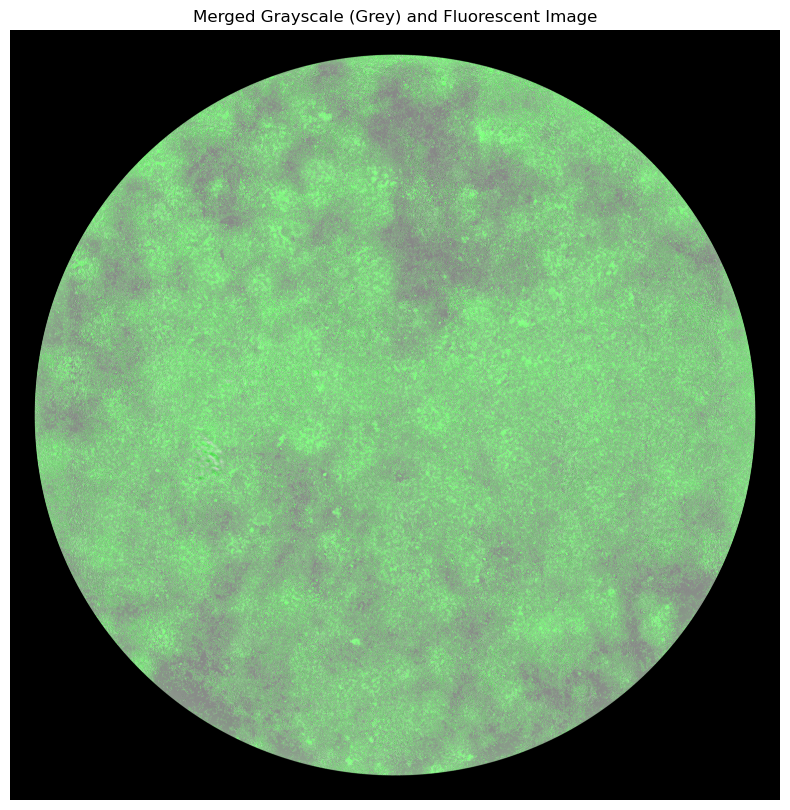

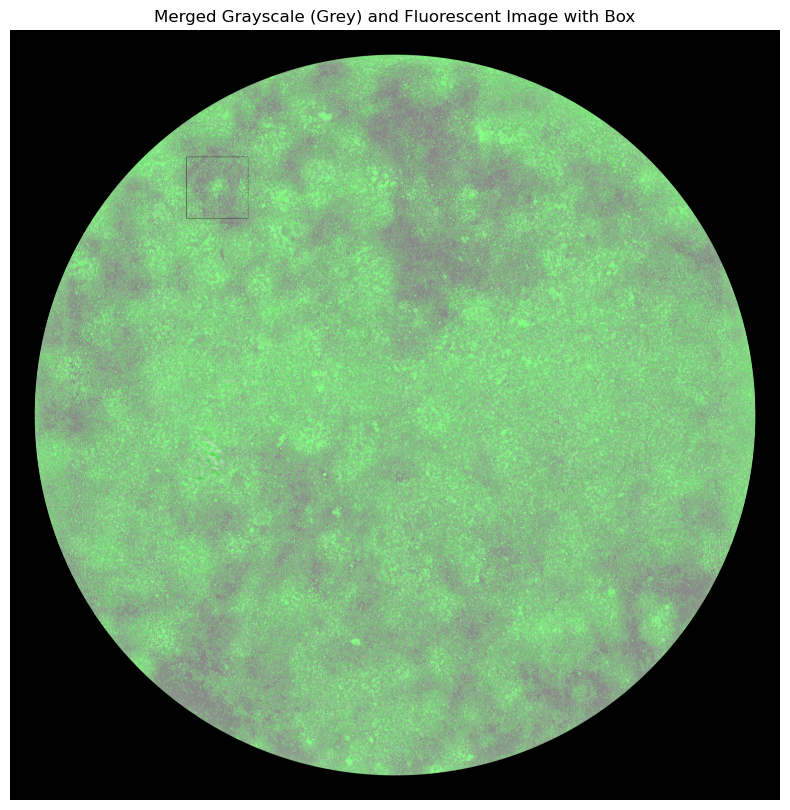

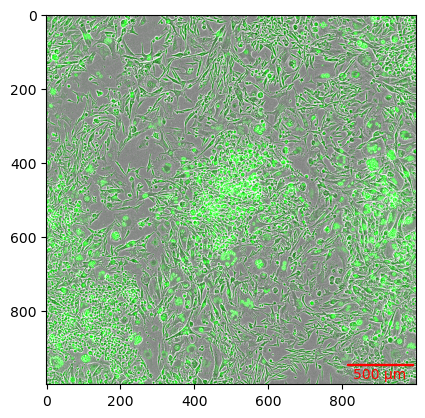

In [22]:
# Paths to the images
phase_image_path = Path(path_to_imgs + 'DLS083_Plate2_Phase_B2_1_30d00h50m.tif')
green_image_path = Path(path_to_imgs+'DLS083_Plate2_Green_B2_1_30d00h50m.tif')

# Read phase tiff using skimage
p1a1_phase = io.imread(phase_image_path)
h, w = p1a1_phase.shape
lum_im = Image.new('L', [w, h], 0)
draw = ImageDraw.Draw(lum_im)
draw.pieslice([(400, 400), (h - 400, w - 400)], 0, 360, fill=1)
lum_im_arr = np.asarray(lum_im)

# Rescale the intensity of the phase image
p1a1_phase_stretch = exposure.rescale_intensity(p1a1_phase, in_range=(120, 135), out_range='dtype').astype(np.float32)
# Cut the image and ensure background is zero
p1a1_phase_stretch_cut = p1a1_phase_stretch.copy()
p1a1_phase_stretch_cut[lum_im_arr == 0] = 0  # This line ensures background is zero

# Save the processed phase image
io.imsave('Plate2_WellB2_Phase.tif', p1a1_phase_stretch_cut.astype(np.float32))

# Read GFP tag tiff using skimage
p1a1_green = io.imread(green_image_path)
# Cut the image
p1a1_green_cut = p1a1_green.copy()
p1a1_green_cut[lum_im_arr == 0] = 0
# Rescale the intensity of the green image
p1a1_green_cut_stretch = exposure.rescale_intensity(p1a1_green_cut, in_range=(0, 300), out_range='dtype').astype(np.float32)

# Save the rescaled green image
io.imsave('Plate2_WellB2_Green.tif', p1a1_green_cut_stretch.astype(np.float32))

# Normalize images to range [0, 1]
p1a1_phase_stretch_cut_scale = exposure.rescale_intensity(p1a1_phase_stretch_cut, in_range='image', out_range=(0, 1))
p1a1_green_cut_stretch_scale = exposure.rescale_intensity(p1a1_green_cut_stretch, in_range='image', out_range=(0, 1))

# Create RGB version of grayscale image (grey)
grey_rgb_image = np.stack((p1a1_phase_stretch_cut_scale, p1a1_phase_stretch_cut_scale, p1a1_phase_stretch_cut_scale), axis=-1)

# Overlay the fluorescent image on top of the grey RGB image
# Assuming we want to overlay the fluorescent image in green channel
combined_image = grey_rgb_image.copy()
combined_image[..., 1] = np.maximum(grey_rgb_image[..., 1], p1a1_green_cut_stretch_scale)

# Display the result
plt.figure(figsize=(10, 10))
plt.imshow(combined_image)
plt.axis('off')
plt.title('Merged Grayscale (Grey) and Fluorescent Image')
plt.show()

# Save the combined image
tifffile.imwrite('Plate2_WellB2_merged.tif', (combined_image * 255).astype(np.uint8))

# Draw a box where the crop will be performed
rect_start = (3360 - 500, 2554 - 500)
rect_end = (3360 + 500, 2554 + 500)
rect_color = (1, 0, 0)  # Red color for the box

# Draw the rectangle on the combined image
combined_image_with_box = combined_image.copy()
combined_image_with_box = Image.fromarray((combined_image_with_box * 255).astype(np.uint8))
draw = ImageDraw.Draw(combined_image_with_box)
draw.rectangle([rect_start, rect_end], outline=rect_color, width=5)

# Display the result with the box
plt.figure(figsize=(10, 10))
plt.imshow(combined_image_with_box)
plt.axis('off')
plt.title('Merged Grayscale (Grey) and Fluorescent Image with Box')
plt.show()

# Save the combined image with the box
combined_image_with_box.save('Plate2_WellB2_merged_with_box.tif')

plt.imshow(combined_image, cmap = 'gray', vmin = 0, vmax = 1)
scalebar = AnchoredSizeBar(plt.gca().transData,
                           1798.561, '5 mm', 'lower right',
                           pad=0.1,
                           color='red',
                           frameon=False,
                           size_vertical=1)
plt.gca().add_artist(scalebar)
plt.savefig('Plate2_WellB2_merged_scale.tif')
plt.close()

# crop out a single clone
crop = combined_image[2554-500:2554+500,3360-500:3360+500]
tifffile.imwrite('Plate2_WellB2_merged_crop.tif', (crop * 255).astype(np.uint8))


plt.imshow(crop, cmap = 'gray', vmin = 0, vmax = 1)
scalebar = AnchoredSizeBar(plt.gca().transData,
                           179.8561, '500 µm', 'lower right',
                           pad=0.1,
                           color='red',
                           frameon=False,
                           size_vertical=1)
plt.gca().add_artist(scalebar)
plt.savefig('Plate2_WellB2_merged_crop_scale.tif')

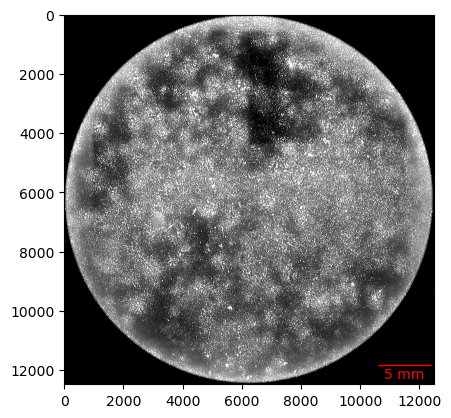

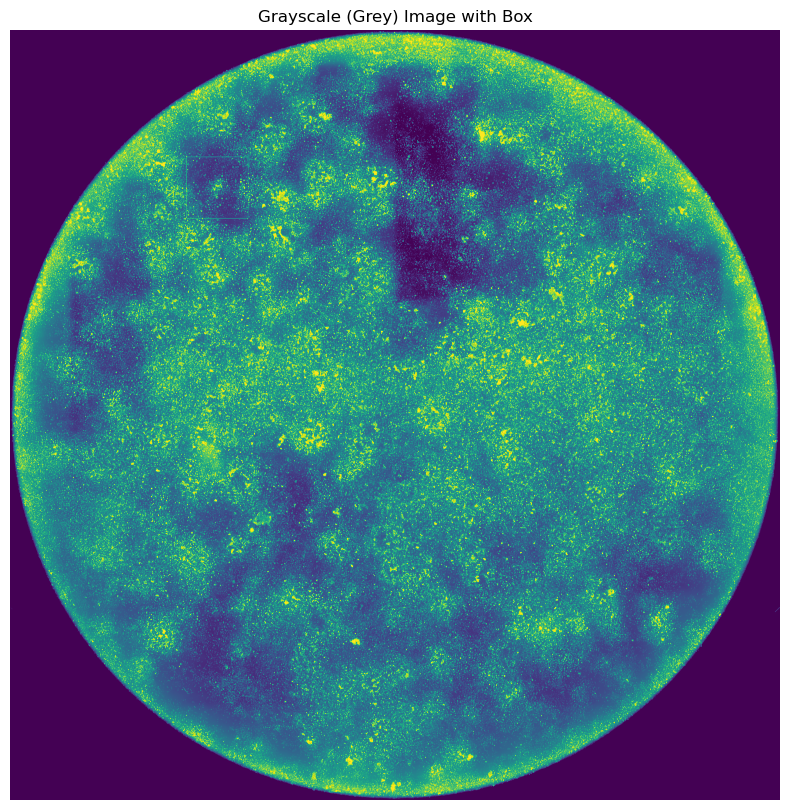

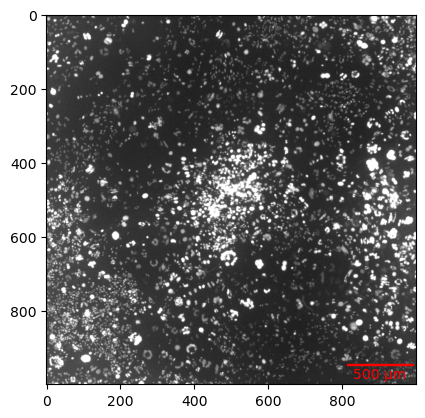

In [23]:
# Code for contrasting just the green image in greyscale
# read  tiff using skimage
green_image_path = Path(path_to_imgs+'DLS083_Plate2_Green_B2_1_30d00h50m.tif')
green_image = io.imread(green_image_path, as_gray=True).astype(np.float32)

# Rescale the intensity based on contrasting range
p2b2_green_stretch = exposure.rescale_intensity(green_image, in_range=(125 ,300), out_range='dtype').astype(np.float32)
plt.imshow(p2b2_green_stretch,cmap='gray', vmin=0, vmax=1)

scalebar = AnchoredSizeBar(plt.gca().transData,
                           1798.561, '5 mm', 'lower right',
                           pad=0.1,
                           color='red',
                           frameon=False,
                           size_vertical=1)
plt.gca().add_artist(scalebar)
plt.savefig('Plate2_B2_scalebar_Green_in_Grey.pdf')
plt.show()
# Save the full image 
io.imsave('Plate2_B2_Green_in_Grey.tif', p2b2_green_stretch)

# Draw a box where the crop will be performed
rect_start = (3360 - 500, 2554 - 500)
rect_end = (3360 + 500, 2554 + 500)
rect_color = (1, 0, 0)  # Red color for the box

# Draw the rectangle on the combined image
p2b2_green_stretch_with_box = p2b2_green_stretch.copy()
p2b2_green_stretch_with_box = Image.fromarray((p2b2_green_stretch_with_box * 255).astype(np.uint8))
draw = ImageDraw.Draw(p2b2_green_stretch_with_box)
draw.rectangle([rect_start, rect_end], outline='white', width=5)

# Display the result with the box
plt.figure(figsize=(10, 10))
plt.imshow(p2b2_green_stretch_with_box)
plt.axis('off')
plt.title('Grayscale (Grey) Image with Box')
plt.show()

# Save the combined image with the box
p2b2_green_stretch_with_box.save('Plate2_B2_Green_in_Grey_with_box.tif')

# crop out a single clone
crop = p2b2_green_stretch[2554-500:2554+500,3360-500:3360+500]
tifffile.imwrite('Plate2_B2_Green_in_Grey_crop.tif', (crop * 255).astype(np.uint8))


plt.imshow(crop, cmap = 'gray', vmin = 0, vmax = 1)
scalebar = AnchoredSizeBar(plt.gca().transData,
                           179.8561, '500 µm', 'lower right',
                           pad=0.1,
                           color='red',
                           frameon=False,
                           size_vertical=1)
plt.gca().add_artist(scalebar)
plt.savefig('Plate2_B2_Green_in_Grey_crop_scale.pdf')

Plate2 B3

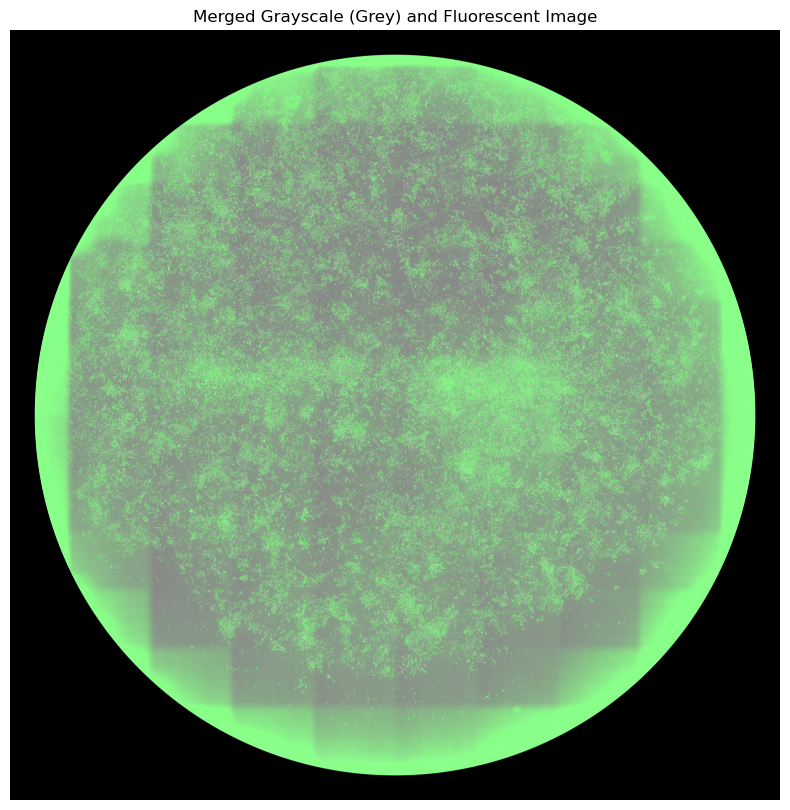

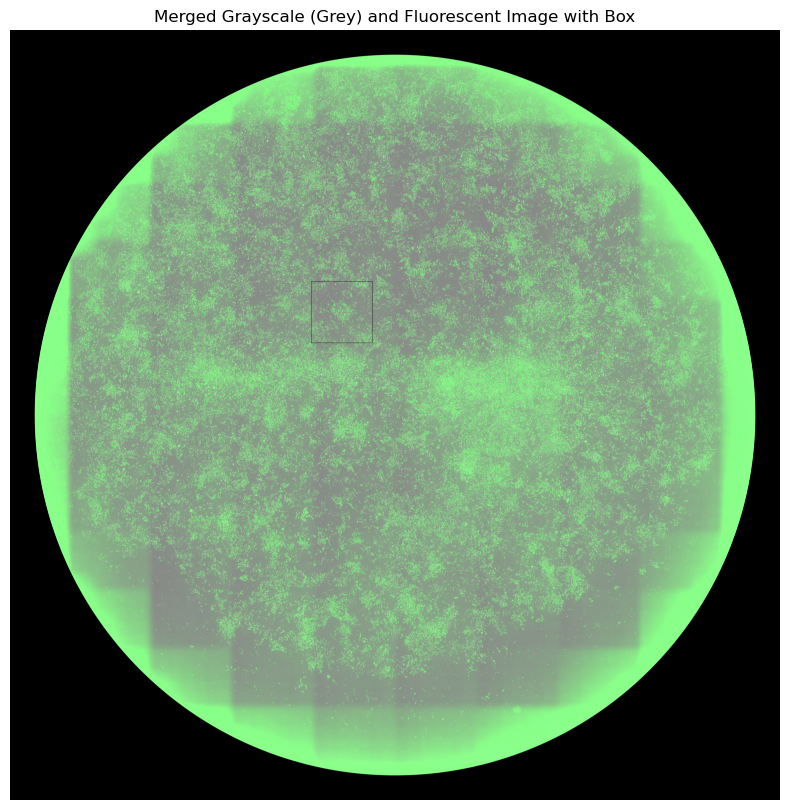

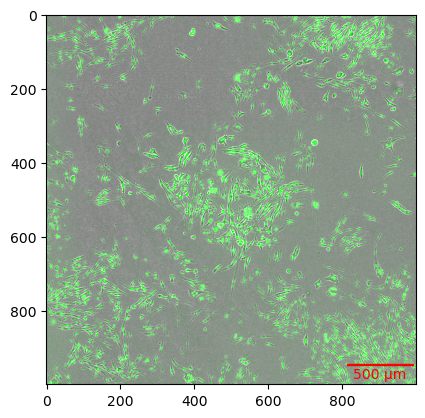

In [24]:
# Paths to the images
phase_image_path = Path(path_to_imgs + 'DLS083_Plate2_Phase_B3_1_30d00h50m.tif')
green_image_path = Path(path_to_imgs+'DLS083_Plate2_Green_B3_1_30d00h50m.tif')

# Read phase tiff using skimage
p1a1_phase = io.imread(phase_image_path)
h, w = p1a1_phase.shape
lum_im = Image.new('L', [w, h], 0)
draw = ImageDraw.Draw(lum_im)
draw.pieslice([(400, 400), (h - 400, w - 400)], 0, 360, fill=1)
lum_im_arr = np.asarray(lum_im)

# Rescale the intensity of the phase image
p1a1_phase_stretch = exposure.rescale_intensity(p1a1_phase, in_range=(120, 135), out_range='dtype').astype(np.float32)
# Cut the image and ensure background is zero
p1a1_phase_stretch_cut = p1a1_phase_stretch.copy()
p1a1_phase_stretch_cut[lum_im_arr == 0] = 0  # This line ensures background is zero

# Save the processed phase image
io.imsave('Plate2_WellB3_Phase.tif', p1a1_phase_stretch_cut.astype(np.float32))

# Read GFP tag tiff using skimage
p1a1_green = io.imread(green_image_path)
# Cut the image
p1a1_green_cut = p1a1_green.copy()
p1a1_green_cut[lum_im_arr == 0] = 0
# Rescale the intensity of the green image
p1a1_green_cut_stretch = exposure.rescale_intensity(p1a1_green_cut, in_range=(0, 100), out_range='dtype').astype(np.float32)

# Save the rescaled green image
io.imsave('Plate2_WellB3_Green.tif', p1a1_green_cut_stretch.astype(np.float32))

# Normalize images to range [0, 1]
p1a1_phase_stretch_cut_scale = exposure.rescale_intensity(p1a1_phase_stretch_cut, in_range='image', out_range=(0, 1))
p1a1_green_cut_stretch_scale = exposure.rescale_intensity(p1a1_green_cut_stretch, in_range='image', out_range=(0, 1))

# Create RGB version of grayscale image (grey)
grey_rgb_image = np.stack((p1a1_phase_stretch_cut_scale, p1a1_phase_stretch_cut_scale, p1a1_phase_stretch_cut_scale), axis=-1)

# Overlay the fluorescent image on top of the grey RGB image
# Assuming we want to overlay the fluorescent image in green channel
combined_image = grey_rgb_image.copy()
combined_image[..., 1] = np.maximum(grey_rgb_image[..., 1], p1a1_green_cut_stretch_scale)

# Display the result
plt.figure(figsize=(10, 10))
plt.imshow(combined_image)
plt.axis('off')
plt.title('Merged Grayscale (Grey) and Fluorescent Image')
plt.show()

# Save the combined image
tifffile.imwrite('Plate2_WellB3_merged.tif', (combined_image * 255).astype(np.uint8))

# Draw a box where the crop will be performed
rect_start = (5380 - 500, 4572 - 500)
rect_end = (5380 + 500, 4572 + 500)
rect_color = (1, 0, 0)  # Red color for the box

# Draw the rectangle on the combined image
combined_image_with_box = combined_image.copy()
combined_image_with_box = Image.fromarray((combined_image_with_box * 255).astype(np.uint8))
draw = ImageDraw.Draw(combined_image_with_box)
draw.rectangle([rect_start, rect_end], outline=rect_color, width=5)

# Display the result with the box
plt.figure(figsize=(10, 10))
plt.imshow(combined_image_with_box)
plt.axis('off')
plt.title('Merged Grayscale (Grey) and Fluorescent Image with Box')
plt.show()

# Save the combined image with the box
combined_image_with_box.save('Plate2_WellB3_merged_with_box.tif')

plt.imshow(combined_image, cmap = 'gray', vmin = 0, vmax = 1)
scalebar = AnchoredSizeBar(plt.gca().transData,
                           1798.561, '5 mm', 'lower right',
                           pad=0.1,
                           color='red',
                           frameon=False,
                           size_vertical=1)
plt.gca().add_artist(scalebar)
plt.savefig('Plate2_WellB3_merged_scale.tif')
plt.close()

# crop out a single clone
crop = combined_image[4572-500:4572+500,5380-500:5380+500]
tifffile.imwrite('Plate2_WellB3_merged_crop.tif', (crop * 255).astype(np.uint8))


plt.imshow(crop, cmap = 'gray', vmin = 0, vmax = 1)
scalebar = AnchoredSizeBar(plt.gca().transData,
                           179.8561, '500 µm', 'lower right',
                           pad=0.1,
                           color='red',
                           frameon=False,
                           size_vertical=1)
plt.gca().add_artist(scalebar)
plt.savefig('Plate2_WellB3_merged_crop_scale.tif')

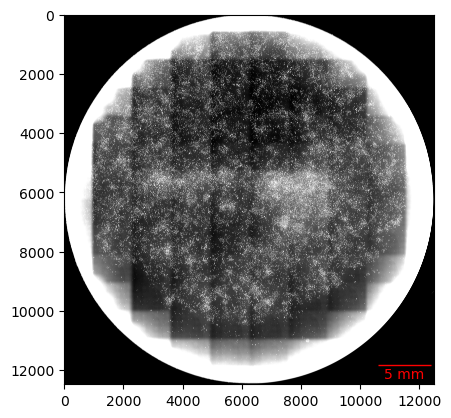

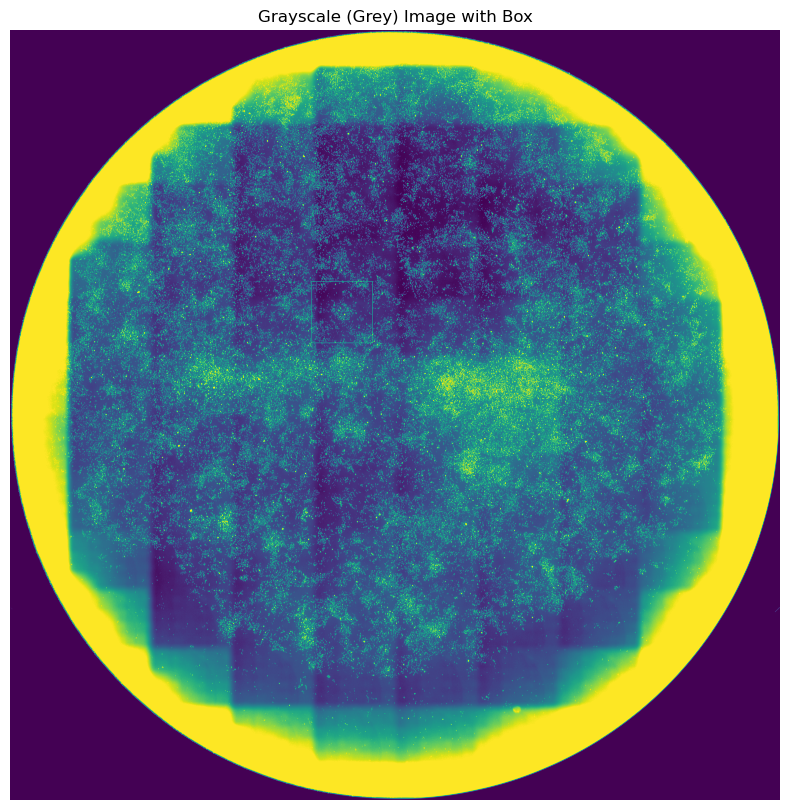

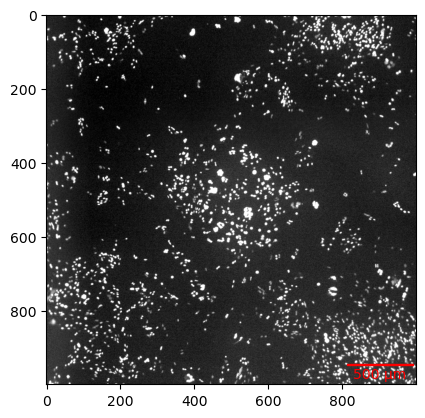

In [25]:
# Code for contrasting just the green image in greyscale
# read  tiff using skimage
green_image_path = Path(path_to_imgs+'DLS083_Plate2_Green_B3_1_30d00h50m.tif')
green_image = io.imread(green_image_path, as_gray=True).astype(np.float32)

# Rescale the intensity based on contrasting range
p2b3_green_stretch = exposure.rescale_intensity(green_image, in_range=(50 ,100), out_range='dtype').astype(np.float32)
plt.imshow(p2b3_green_stretch,cmap='gray', vmin=0, vmax=1)

scalebar = AnchoredSizeBar(plt.gca().transData,
                           1798.561, '5 mm', 'lower right',
                           pad=0.1,
                           color='red',
                           frameon=False,
                           size_vertical=1)
plt.gca().add_artist(scalebar)
plt.savefig('Plate2_B3_scalebar_Green_in_Grey.pdf')
plt.show()
# Save the full image 
io.imsave('Plate2_B3_Green_in_Grey.tif', p2b3_green_stretch)

# Draw a box where the crop will be performed
rect_start = (5380 - 500, 4572 - 500)
rect_end = (5380 + 500, 4572 + 500)
rect_color = (1, 0, 0)  # Red color for the box

# Draw the rectangle on the combined image
p2b3_green_stretch_with_box = p2b3_green_stretch.copy()
p2b3_green_stretch_with_box = Image.fromarray((p2b3_green_stretch_with_box * 255).astype(np.uint8))
draw = ImageDraw.Draw(p2b3_green_stretch_with_box)
draw.rectangle([rect_start, rect_end], outline='white', width=5)

# Display the result with the box
plt.figure(figsize=(10, 10))
plt.imshow(p2b3_green_stretch_with_box)
plt.axis('off')
plt.title('Grayscale (Grey) Image with Box')
plt.show()

# Save the combined image with the box
p2b3_green_stretch_with_box.save('Plate2_B3_Green_in_Grey_with_box.tif')

# crop out a single clone
crop = p2b3_green_stretch[4572-500:4572+500,5380-500:5380+500]
tifffile.imwrite('Plate2_B3_Green_in_Grey_crop.tif', (crop * 255).astype(np.uint8))


plt.imshow(crop, cmap = 'gray', vmin = 0, vmax = 1)
scalebar = AnchoredSizeBar(plt.gca().transData,
                           179.8561, '500 µm', 'lower right',
                           pad=0.1,
                           color='red',
                           frameon=False,
                           size_vertical=1)
plt.gca().add_artist(scalebar)
plt.savefig('Plate2_B3_Green_in_Grey_crop_scale.pdf')